<div style="text-align: center;">  
     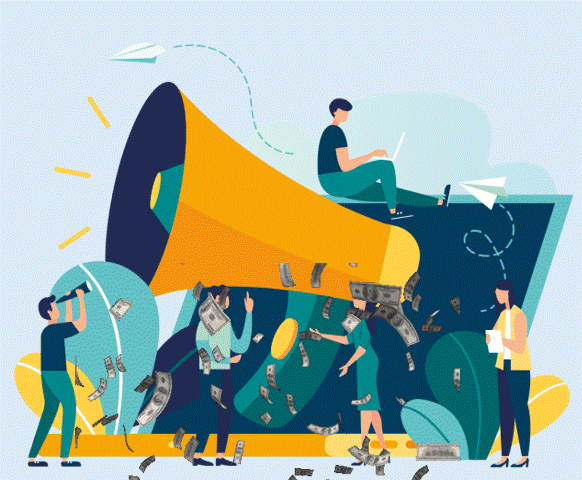
</div>
r>v>

<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:100%; text-align:left">

<h3 align="left"><font color=black>Problem Statement:</font></h3>

<h8 align="left"><font color=black>In this project, our goal is to classify customers for marketing campaigns based on their spending habits, using customer data. This will allow us to offer products they prefer and measure the success of campaigns based on tailored recommendations for each category. evaluate the customer, and ultimately increase the company's sales.</font></h8>
    

**Completing this project will:**
--

* **Segmentation of customer profiles based on spending habits**

* **Increased Campaign successes for more profit:**
* By using a strong classification model, the company can make more informed decisions about marketing campaigns for its customers. Also, this model helps the company to reduce failed campaigns by recommending related products to different types of customers in campaigns.

<a id="contents_tabel"></a>    
<div style="border-radius:10px; padding: 15px; background-color:#C9F1FF; font-size:120%; text-align:left">

<h3 align="left"><font color=black>Table of Contents:</font></h3>

* **[Step 1 | Import Libraries](#import)**
* **[Step 2 | Read Dataset](#read)**
* **[Step 3 | Dataset Overview](#overview)**
    - [Step 3.1 | Dataset Basic Information](#basic)
    - [Step 3.2 | Summary Statistics for Continuous Variables](#cat_statistics)
    - [Step 3.3 | Summary Statistics for Categorical Variables](#can_statistics)
* **[Step 4 | EDA](#eda)**
    - [Step 4.1 | Univariate Analysis](#univariate)
    - [Step 4.2 | Bivariate Analysis](#bivariate)
    - [Step 4.3 | Multivariate Analysis](#multivariate)
* **[Step 5 | Data Preprocessing](#preprocessing)**
    - [Step 5.1 | Irrelevant Features Removal](#removal)
    - [Step 5.2 | Outlier Treatment](#outlier)
    - [Step 5.3 | Missing Value Treatment](#missing)
    - [Step 5.4 | Duplicate data Treatment](#duplicate)
    - [Step 5.5 | Feature Transformation](#Transformation)
* **[Step 6 | Functions required for modeling](#required)**
    - [Step 6.1 | Hyperparameter Tuning with GridSearchCV & RandomSearchCV](#grid)    
    - [Step 6.2 | Evaluation metrics](#metrics)        
    - [Step 6.3 | Feature Selection](#Selection) 
    - [Step 6.4 | Cross validation](#Cross) 
    
* **[Step 7 | Analysis of data to increase sales in business](#Analysis)**
    - [Step 7.1 | Which type of customers generate the most revenue for the business?](#revenue) 
    - [Step 7.2 | Which products contribute most to sales, and which products are less popular?](#products)
    - [Step 7.3 | What factors drive customers to make repeat purchases?](#factors)
    - [Step 7.4 | Is there a correlation between customer income and their purchasing patterns?](#correlation)
    - [Step 7.5 | Are customers who visit the website more frequently more likely to make purchases?](#website)
    - [Step 7.6 | What characteristics do customers who have accepted campaigns share??](#accepted)
    - [Step 7.7 | Are customers who have been successful in one campaign likely to accept subsequent ones?](#subsequent)
    - [Step 7.8 |  Do customers who purchase more frequently accept campaigns more often?](#frequently)
    - [Step 7.9 |  Does the timing or frequency of campaigns affect acceptance rates?](#rates)
    - [Step 7.10 |  What factors cause customers to reject campaigns?](#reject)
* **[Step 8 | Deleting columns created in the analysis](#Deleting)**
* **[Step 9 | Feature Scaling](#Scaling)**
* **[Step 10 | Dimensionality Reduction (PCA)](#PCA)**
* **[Step 11 | K_Means Clustering](#KMeans)**
* **[Step 13 | DBSCAN Clustering](#dbscanclustering)**


<a id="import"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 1: Import Libraries</p>

⬆️[Tabel of Contents](#contents_tabel)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import OneHotEncoder,StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans,DBSCAN
from sklearn.metrics import silhouette_score,davies_bouldin_score,calinski_harabasz_score
from yellowbrick.cluster import SilhouetteVisualizer,KElbowVisualizer
import plotly.graph_objects as go
from math import pi
from collections import Counter
from sklearn.neighbors import NearestNeighbors

<a id="import"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 2: Read Dataset</p>

⬆️[Tabel of Contents](#contents_tabel)

In [2]:
data=pd.read_csv("C:/Users/Shirin/marketing_campaign.csv",sep='\t')

In [3]:
data.iloc[:,0:15]

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds
0,5524,1957,Graduation,Single,58138.0,0,0,04-09-2012,58,635,88,546,172,88,88
1,2174,1954,Graduation,Single,46344.0,1,1,08-03-2014,38,11,1,6,2,1,6
2,4141,1965,Graduation,Together,71613.0,0,0,21-08-2013,26,426,49,127,111,21,42
3,6182,1984,Graduation,Together,26646.0,1,0,10-02-2014,26,11,4,20,10,3,5
4,5324,1981,PhD,Married,58293.0,1,0,19-01-2014,94,173,43,118,46,27,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,13-06-2013,46,709,43,182,42,118,247
2236,4001,1946,PhD,Together,64014.0,2,1,10-06-2014,56,406,0,30,0,0,8
2237,7270,1981,Graduation,Divorced,56981.0,0,0,25-01-2014,91,908,48,217,32,12,24
2238,8235,1956,Master,Together,69245.0,0,1,24-01-2014,8,428,30,214,80,30,61


In [4]:
data.iloc[:,15:]

,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,3,8,10,4,7,0,0,0,0,0,0,3,11,1
1,2,1,1,2,5,0,0,0,0,0,0,3,11,0
2,1,8,2,10,4,0,0,0,0,0,0,3,11,0
3,2,2,0,4,6,0,0,0,0,0,0,3,11,0
4,5,5,3,6,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,2,9,3,4,5,0,0,0,0,0,0,3,11,0
2236,7,8,2,5,7,0,0,0,1,0,0,3,11,0
2237,1,2,3,13,6,0,1,0,0,0,0,3,11,0
2238,2,6,5,10,3,0,0,0,0,0,0,3,11,0


<div style="background-color:#C9F1FF;border-radius:10px; padding:20px; font-size:15px">

|       | **Columns**            | **Information**                                                                      |
| :---  | :---                   | :---                                                                                 |      
| **1** | ID                     | Unique identifier for each customer                                                  |                
| **2** | Year_Birth             | Customer's birth year                                                                |                        
| **3** | Education              | Customer's education level                                                           |
| **4** | Marital_Status         | Customer's marital status                                                            |
| **5** | Income                 | Customer's annual income                                                             |                     
| **6** | Kidhome                | Number of young children in the household                                            |
| **7** | Teenhome               | Number of teenagers in the household                                                 |              
| **8** | Dt_Customer            | Date the customer enrolled                                                           |       
| **9** | Recency                | Number of days since the last purchase                                               |
| **10** | MntWines              | Amount spent on wine in the last 2 years                                             |                
| **11** | MntFruits             | Amount spent on fruits in the last 2 years                                           |                        
| **12** | MntMeatProducts       | Amount spent on meat products in the last 2 years                                    |
| **13** | MntFishProducts       | Amount spent on fish products in the last 2 years                                    |
| **14** | MntSweetProducts      | Amount spent on sweet products in the last 2 years                                   |
| **15** | MntGoldProds          | Amount spent on gold products in the last 2 years                                    |                     
| **16** | NumDealsPurchases     | Number of purchases made with a discount                                             |
| **17** | NumWebPurchases       | Number of purchases made through the web                                             |              
| **18** | NumCatalogPurchases   | Number of purchases made using a catalog                                             |       
| **19** | NumStorePurchases     | Number of purchases made directly in stores                                          |
| **20** | NumWebVisitsMonth     | Number of visits to the website per month                                            |                
| **21** | AcceptedCmp3          | Whether the customer accepted Campaign 3                                             |                        
| **22** | AcceptedCmp4          | Whether the customer accepted Campaign 4                                             |
| **23** | AcceptedCmp5          | Whether the customer accepted Campaign 5                                             |
| **24** | AcceptedCmp1          | Whether the customer accepted Campaign 1                                             |
| **25** | AcceptedCmp2          | Whether the customer accepted Campaign 2                                             |                     
| **26** | Complain              | Whether the customer made a complaint                                                |
| **27** | Z_CostContact         | Cost of contacting the customer                                                      |              
| **28** | Z_Revenue             | Revenue from the campaign                                                            |
| **29** | Response              | Whether the customer responded to the campaign                                       |

</div>


<a id="import"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 3: Dataset Overview</p>

⬆️[Tabel of Contents](#contents_tabel)

<a id="basic"></a>
# <b><span style='color:#215F9A'>Step 3.1 |</span><span style='color:black'> Dataset Basic Information</span></b>

In [5]:
data.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response'],
      dtype='object')

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2240 entries, 0 to 2239
Data columns (total 29 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   ID                   2240 non-null   int64  
 1   Year_Birth           2240 non-null   int64  
 2   Education            2240 non-null   object 
 3   Marital_Status       2240 non-null   object 
 4   Income               2216 non-null   float64
 5   Kidhome              2240 non-null   int64  
 6   Teenhome             2240 non-null   int64  
 7   Dt_Customer          2240 non-null   object 
 8   Recency              2240 non-null   int64  
 9   MntWines             2240 non-null   int64  
 10  MntFruits            2240 non-null   int64  
 11  MntMeatProducts      2240 non-null   int64  
 12  MntFishProducts      2240 non-null   int64  
 13  MntSweetProducts     2240 non-null   int64  
 14  MntGoldProds         2240 non-null   int64  
 15  NumDealsPurchases    2240 non-null   i

<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:110%; text-align:left">

<h2 align="left"><font color=#524712>Information:</font></h2>

* **Missing Value and Object data ,Recognition:**
   - The total data is 2240, so if any column has less than this value, it means there is a missing value in that column..
   - There are 34 missing values in the <b>Income</b> feature.
   - In this dataset, three columns of data are of object type <b>(Education, Marital_Status,  Dt_Customer) </b> and object type data cannot be used in machine learning, so they must be changed in the next steps.

<a id="cat_statistics"></a>
# <b><span style='color:#215F9A'>Step 3.2 |</span><span style='color:black'> Identifying discrete and continuous features</span></b>

In [7]:
data.nunique()

ID                     2240
Year_Birth               59
Education                 5
Marital_Status            8
Income                 1974
Kidhome                   3
Teenhome                  3
Dt_Customer             663
Recency                 100
MntWines                776
MntFruits               158
MntMeatProducts         558
MntFishProducts         182
MntSweetProducts        177
MntGoldProds            213
NumDealsPurchases        15
NumWebPurchases          15
NumCatalogPurchases      14
NumStorePurchases        14
NumWebVisitsMonth        16
AcceptedCmp3              2
AcceptedCmp4              2
AcceptedCmp5              2
AcceptedCmp1              2
AcceptedCmp2              2
Complain                  2
Z_CostContact             1
Z_Revenue                 1
Response                  2
dtype: int64

In [8]:
data_categorical=data[['Education', 'Marital_Status',  'Kidhome',
       'Teenhome', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response']]

In [9]:
data_categorical.head()

,Education,Marital_Status,Kidhome,Teenhome,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,Graduation,Single,0,0,3,8,10,4,7,0,0,0,0,0,0,3,11,1
1,Graduation,Single,1,1,2,1,1,2,5,0,0,0,0,0,0,3,11,0
2,Graduation,Together,0,0,1,8,2,10,4,0,0,0,0,0,0,3,11,0
3,Graduation,Together,1,0,2,2,0,4,6,0,0,0,0,0,0,3,11,0
4,PhD,Married,1,0,5,5,3,6,5,0,0,0,0,0,0,3,11,0


In [10]:
data_continuous=data.drop(data_categorical,axis=1)

In [11]:
data_continuous.head()

,ID,Year_Birth,Income,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds
0,5524,1957,58138.0,04-09-2012,58,635,88,546,172,88,88
1,2174,1954,46344.0,08-03-2014,38,11,1,6,2,1,6
2,4141,1965,71613.0,21-08-2013,26,426,49,127,111,21,42
3,6182,1984,26646.0,10-02-2014,26,11,4,20,10,3,5
4,5324,1981,58293.0,19-01-2014,94,173,43,118,46,27,15


<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:85%; text-align:left">

<h2 align="left"><font color=#524712><b>Dt_Customer</b>:</font></h2>
Because DT is an object and time series, it cannot be plotted here, so we remove the day and month from this column and keep only the year. Now this feature becomes categorical.

In [12]:
data_categorical['Year'] = pd.to_datetime(data_continuous['Dt_Customer'], format='%d-%m-%Y', dayfirst=True, errors='coerce').dt.year

In [13]:
data_categorical.head()

,Education,Marital_Status,Kidhome,Teenhome,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response,Year
0,Graduation,Single,0,0,3,8,10,4,7,0,0,0,0,0,0,3,11,1,2012
1,Graduation,Single,1,1,2,1,1,2,5,0,0,0,0,0,0,3,11,0,2014
2,Graduation,Together,0,0,1,8,2,10,4,0,0,0,0,0,0,3,11,0,2013
3,Graduation,Together,1,0,2,2,0,4,6,0,0,0,0,0,0,3,11,0,2014
4,PhD,Married,1,0,5,5,3,6,5,0,0,0,0,0,0,3,11,0,2014


In [14]:
data_continuous=data_continuous.drop('Dt_Customer',axis=1)

<a id="cat_statistics"></a>
# <b><span style='color:#215F9A'>Step 3.3 |</span><span style='color:black'> Summary Statistics for Continuous Variables</span></b>

In [15]:
data_continuous = pd.DataFrame(data_continuous)
pd.options.display.float_format = '{:.2f}'.format
data_continuous.describe().drop(['25%', '50%', '75%', 'count','std']).T

,mean,min,max
ID,5592.16,0.00,11191.00
Year_Birth,1968.81,1893.00,1996.00
Income,52247.25,1730.00,666666.00
Recency,49.11,0.00,99.00
MntWines,303.94,0.00,1493.00
MntFruits,26.30,0.00,199.00
MntMeatProducts,166.95,0.00,1725.00
MntFishProducts,37.53,0.00,259.00
MntSweetProducts,27.06,0.00,263.00
MntGoldProds,44.02,0.00,362.00


<a id="can_statistics"></a>
# <b><span style='color:#215F9A'>Step 3.4 |</span><span style='color:black'> Summary Statistics for Categorical Variables</span></b>

In [16]:
data_categorical = pd.DataFrame(data_categorical)
pd.options.display.float_format = '{:.0f}'.format
data_categorical.describe().drop(['25%', '50%', '75%', 'count','std','mean']).T


,min,max
Kidhome,0,2
Teenhome,0,2
NumDealsPurchases,0,15
NumWebPurchases,0,27
NumCatalogPurchases,0,28
NumStorePurchases,0,13
NumWebVisitsMonth,0,20
AcceptedCmp3,0,1
AcceptedCmp4,0,1
AcceptedCmp5,0,1


<a id="eda"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 4: Exploratory Data Analysis (EDA)</p>

⬆️[Tabel of Contents](#contents_tabel)

<a id="basic"></a>
# <b><span style='color:#215F9A'>Step 4.1 |</span><span style='color:black'> Categorical Variables Univariate Analysis</span></b>

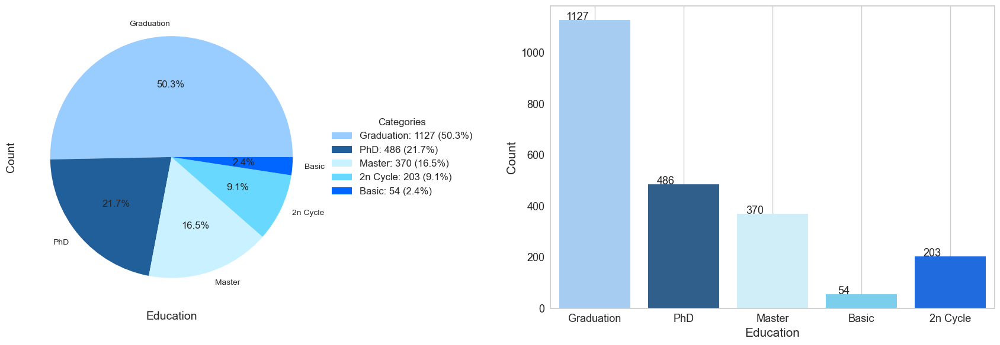

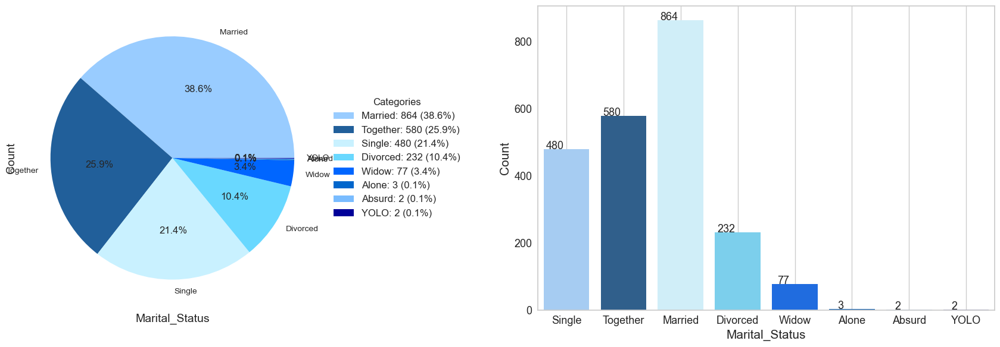

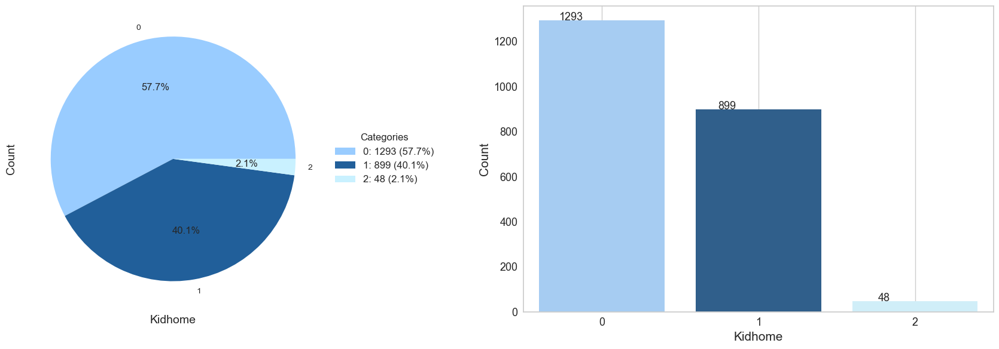

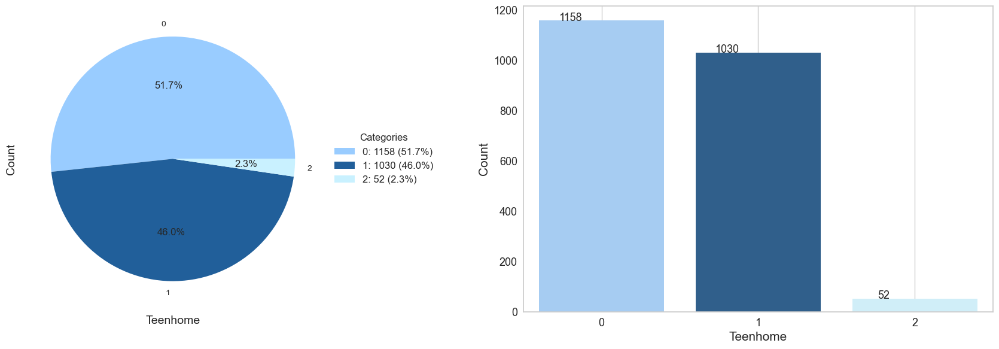

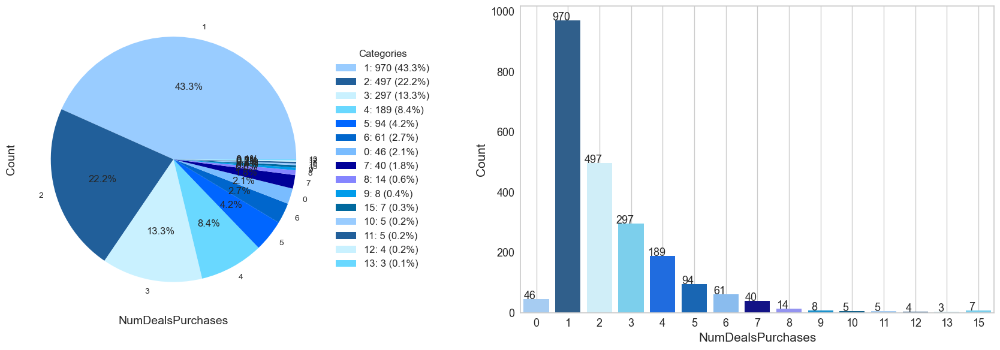

...

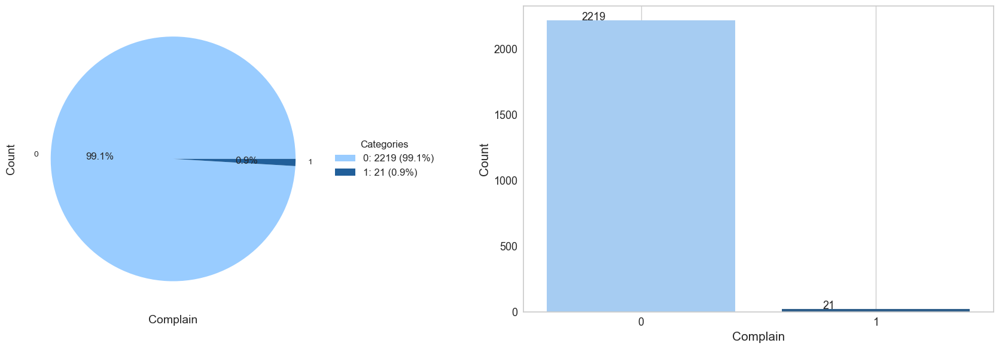

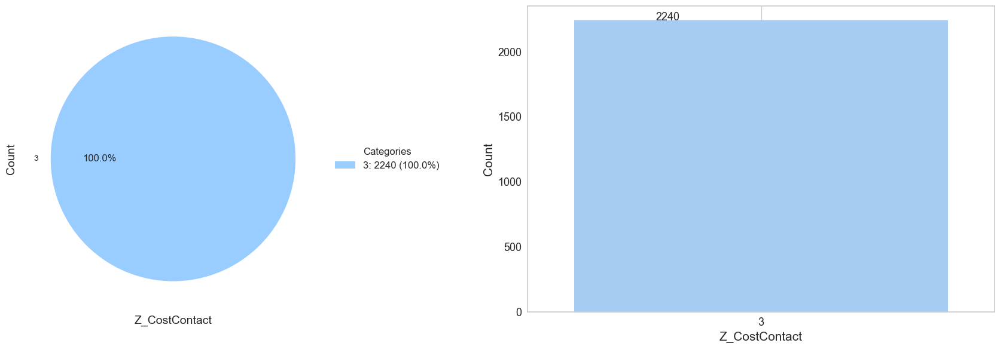

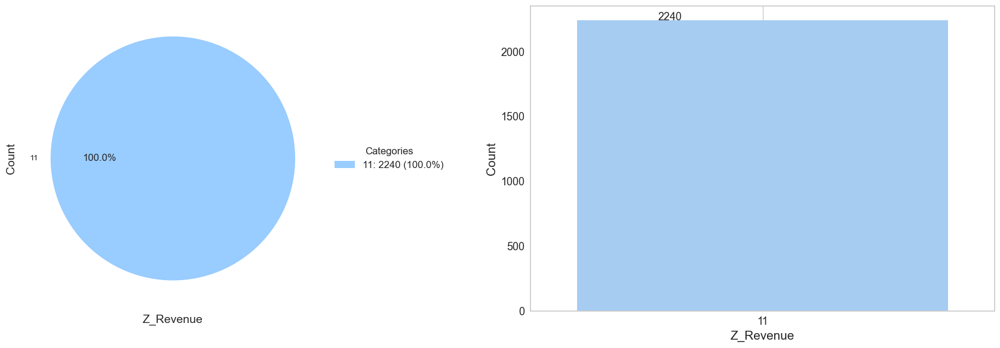

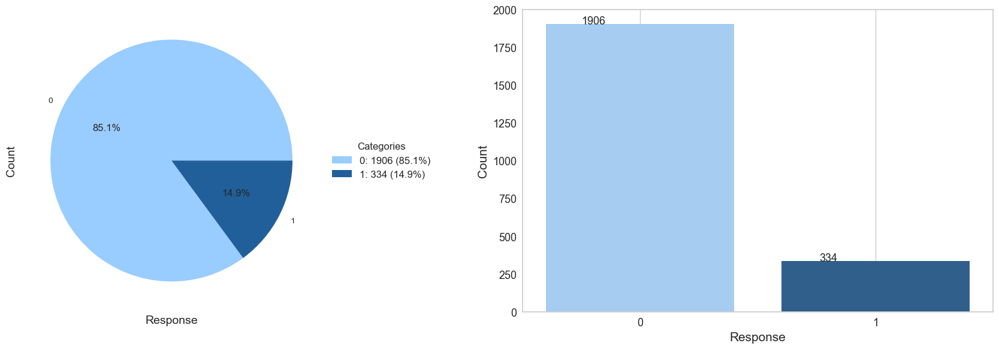

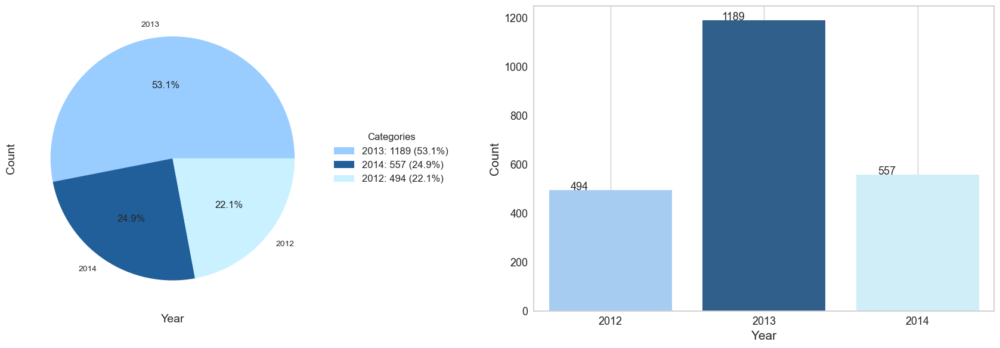

In [17]:
features = data_categorical

for feature in features:
    counts = data_categorical[feature].value_counts()
    percentages = counts / counts.sum() * 100
    colors = ['#99CCFF','#215F9A', '#C9F1FF','#69D8FF','#0066FF','#0066CC', '#79BCFF','#000099','#8585FF','#009CEA','#00699E'] 
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))
    
    # Pie chart
    wedges, _, _ = ax1.pie(counts, labels=counts.index, autopct='%1.1f%%', colors=colors)
    ax1.set_xlabel(feature, fontsize=14)
    ax1.set_ylabel('Count', fontsize=14)
    
    legend_labels = []
    for i, (count, percent) in enumerate(zip(counts, percentages)):
        label = f'{counts.index[i]}: {count} ({percent:.1f}%)'
        legend_labels.append(label)
    
    ax1.legend(wedges, legend_labels, title='Categories', loc='center left', bbox_to_anchor=(1, 0.5), fontsize=12)
    plt.setp(ax1.get_xticklabels(), fontsize=12)
    plt.setp(ax1.get_yticklabels(), fontsize=12)
    
    # Countplot
    ax2 = sns.countplot(x=feature, data=data_categorical, ax=ax2, palette=colors)
    ax2.set_xlabel(feature, fontsize=15)
    ax2.set_ylabel('Count', fontsize=15)
    plt.xticks(fontsize=13)
    plt.yticks(fontsize=13)
    plt.grid()
    for p in ax2.patches:
        ax2.annotate('{:.0f}'.format(p.get_height()), (p.get_x()+0.2, p.get_height()), ha='center', fontsize=13)
    
    plt.tight_layout()
    plt.show()

In [18]:
data_categorical.columns

Index(['Education', 'Marital_Status', 'Kidhome', 'Teenhome',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3',
       'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2',
       'Complain', 'Z_CostContact', 'Z_Revenue', 'Response', 'Year'],
      dtype='object')

<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:110%; text-align:left">

<h2 align="left"><font color=#524712>Information:</font></h2>

* **Education:**
   - Most of the customers are university graduates, Ph.D., and Master's respectively, and a few have basic and cycle education.
     
* **Marital_Status:**
   - Married, together, single, widowed, and divorced customers have bought more from the store respectively.
   - The number of categories of this feature can be reduced by merging similar values.
   - Two values Absurd and YOLO have no effect and can be deleted.
     
* **Kidhome:**
   - The number of customers who do not have children is more than those who have one child and very few have two children.
     
* **Teenhome:**
    - The number of customers who do not have teens is more than those who have one teen and very few have two teens.
      
* **NumDealsPurchases:**
   - Some customers have never bought with a discount.   - Many customers have bought at least once with a discount.   -    - 
A fw customerse have bought twice, a few threetimesm.
   - F finally a small numberof customerse have bought with a discountof  up to 15 ti.e.s
  
* **NumWebPurchases:**
   -A large number of customers have bought through the site and a very small number of customers (49 people) have not purchased from the site at all.

* **NumCatalogPurchases:**
   - Too many customers have not bought through the catalog.

* **NumStorePurchases:**
   - 15 customers did not buy directly from the store at all.
   - 7 customers have bought only once by visiting the store.
   - A large number of customers were willing to buy directly from the store.

* **NumWebVisitsMonth:**
   - Most customers have visited the site between 6 and 8 times.

* **AcceptedCmp 1,2,3,4,5:**
   - The majority of customers have not accepted campaigns.

* **Complain:**
   - Very few customers have complained about the store.

* **Z_CostContact:**
   - Because all the values ​​of this feature are the same, it will not help us. 

* **Z_Revenue:**
   - Because all the values ​​of this feature are the same, it will not help us.
     
* **Response:**
   - A very large number of customers did not respond to the campaigns, and their characteristics should be determined so that they are given suggestions based on the characteristics so that they would be willing to respond to the campaigns and increase the store's sales.
     .
* **Year:**
   -Most of the customers joined this store in 2013.ear'

<a id="basic"></a>
# <b><span style='color:#215F9A'>Step 4.2 |</span><span style='color:black'> Continuous Variables Univariate Analysis</span></b>

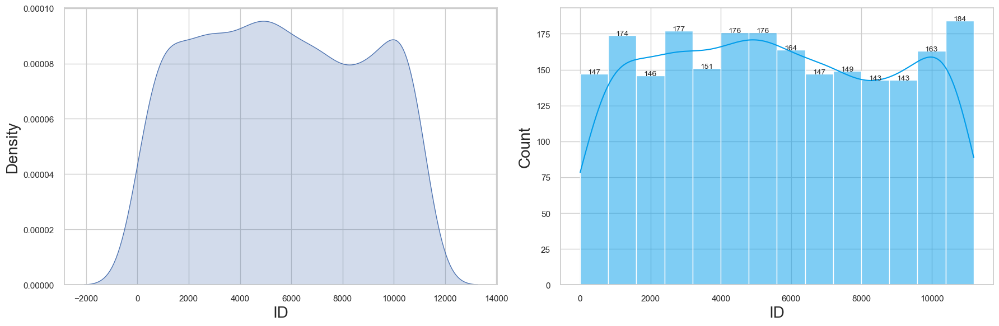

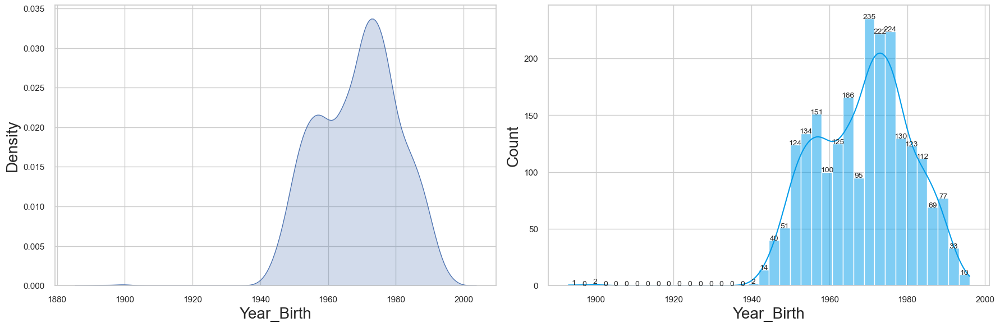

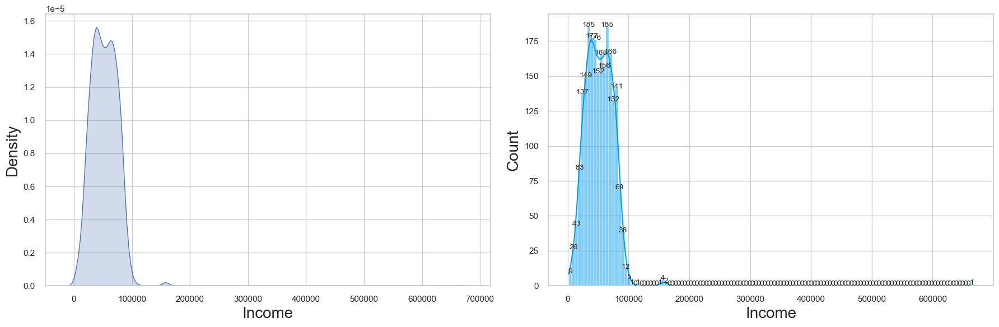

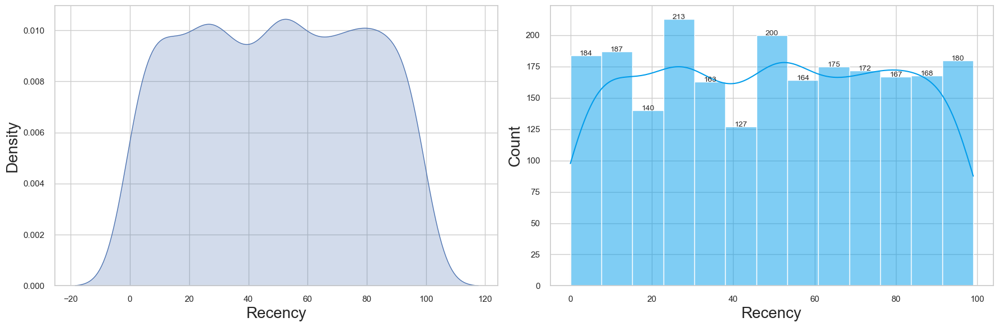

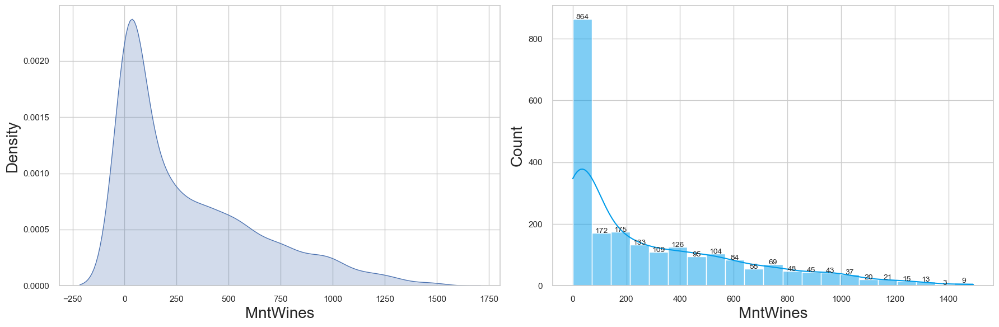

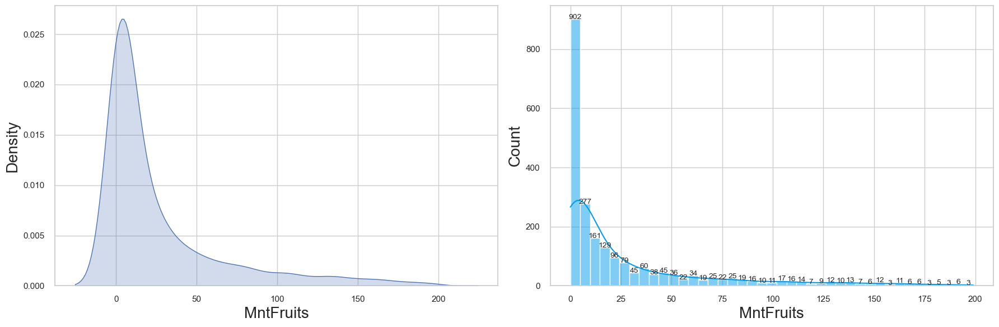

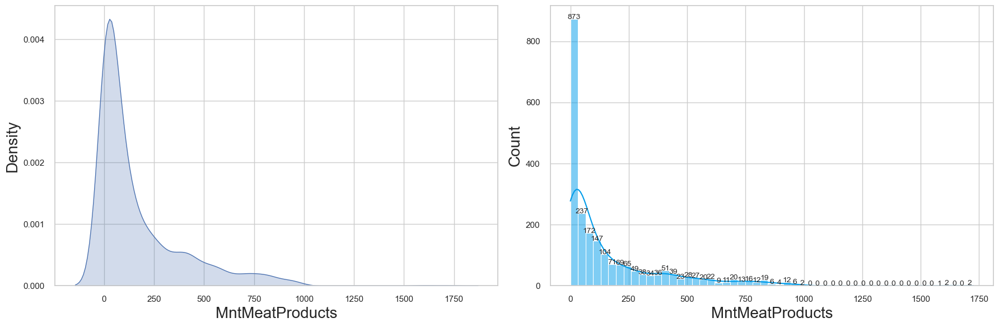

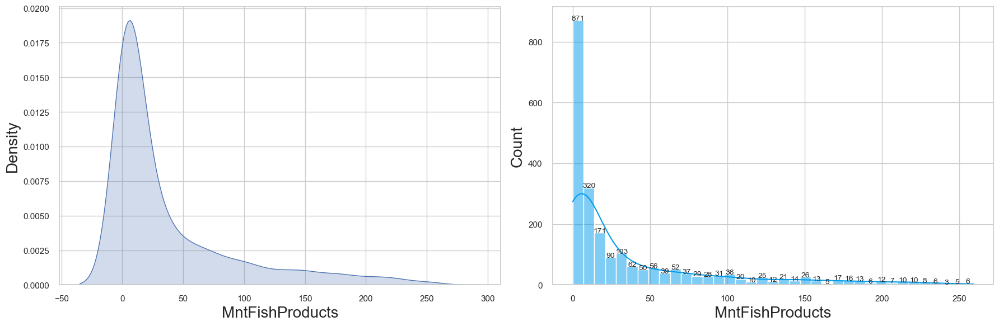

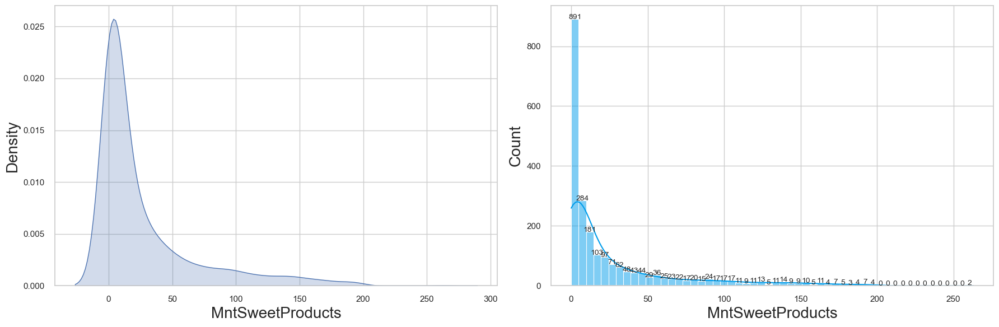

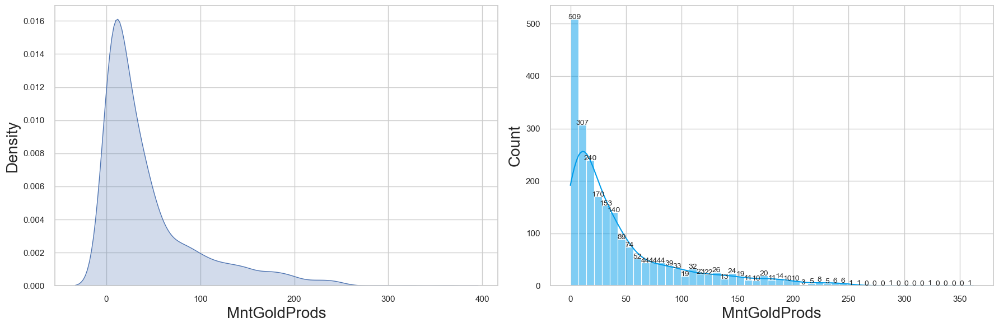

In [19]:
sns.set(style='whitegrid')

cont_cols = data_continuous

for feature in cont_cols:
    sns.set(style='whitegrid')
    
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))
    
    # KDE plot
    palette = ['#c4d9cf'] 
    sns.kdeplot(data=data_continuous, x=feature, shade=True, palette=palette, ax=ax1)
    ax1.set_xlabel(feature, fontsize=20)
    ax1.set_ylabel('Density', fontsize=20)
    
    # Histogram plot
    ax2 = sns.histplot(data=data_continuous, x=feature, color='#009CEA', ax=ax2,kde=True)
    ax2.set_xlabel(feature, fontsize=20)
    ax2.set_ylabel('Count', fontsize=20)
    
    value_counts = data[feature].value_counts()
    for p in ax2.patches:
        ax2.annotate('{:.0f}'.format(p.get_height()), (p.get_x() + p.get_width() / 2, p.get_height()), ha='center', fontsize=10)
        ax2.annotate('', (0.5, 0.9), xycoords='axes fraction', ha='center', fontsize=13, color='red')
    
    plt.tight_layout()
    plt.show()

<a id="preprocessing"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 5:  Data Preprocessing</p>

⬆️[Tabel of Contents](#contents_tabel)

<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:115%; text-align:left">

Data preprocessing is crucial in the machine learning pipeline, particularly for classification tasks. Here's an overview of each. For this project, the following preprocessing steps will be performed:

1. __Irrelevant Feature Removal__
    
2. __Outlier Treatment__

3. __Missing Value Treatment__

4.  __Duplicate data Treatment__
    

<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:115%; text-align:left">
    
First, remove Irrelevant Features in the continuous and categorical datasets:

<a id="irrelevant"></a>
# <b><span style='color:#215F9A'>Step 5.1 |</span><span style='color:black'> Irrelevant Feature Removal</span></b>

In [20]:
data_continuous=data_continuous.drop('ID',axis=1)
data_continuous.head()

,Year_Birth,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds
0,1957,58138,58,635,88,546,172,88,88
1,1954,46344,38,11,1,6,2,1,6
2,1965,71613,26,426,49,127,111,21,42
3,1984,26646,26,11,4,20,10,3,5
4,1981,58293,94,173,43,118,46,27,15


In [21]:
data_categorical=data_categorical.drop(['Z_CostContact', 'Z_Revenue'],axis=1)
data_categorical.head()

,Education,Marital_Status,Kidhome,Teenhome,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Year
0,Graduation,Single,0,0,3,8,10,4,7,0,0,0,0,0,0,1,2012
1,Graduation,Single,1,1,2,1,1,2,5,0,0,0,0,0,0,0,2014
2,Graduation,Together,0,0,1,8,2,10,4,0,0,0,0,0,0,0,2013
3,Graduation,Together,1,0,2,2,0,4,6,0,0,0,0,0,0,0,2014
4,PhD,Married,1,0,5,5,3,6,5,0,0,0,0,0,0,0,2014


<a id="Outlier"></a>
# <b><span style='color:#215F9A'>Step 5.2 |</span><span style='color:black'> Outlier Treatment</span></b>

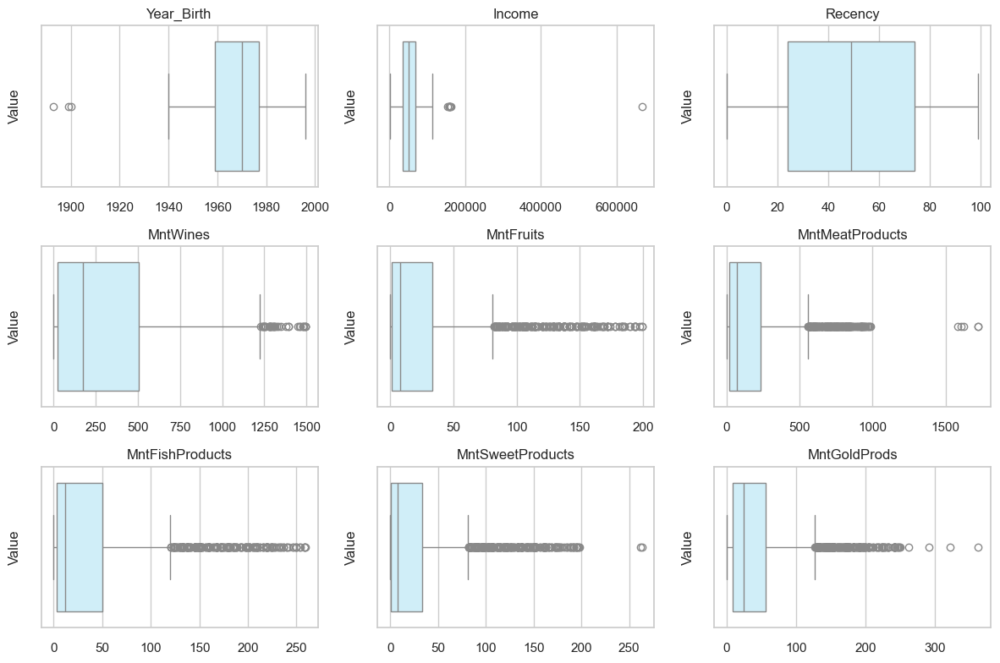

In [22]:
num_cols = 3
num_rows = 3
num_features = len(data_continuous.columns)
fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 8))
feature_num = 0

for i in range(num_rows):
    for j in range(num_cols):
        if feature_num < num_features:
            sns.boxplot(x=data_continuous.iloc[:, feature_num], color='#C9F1FF', ax=axes[i, j])
            axes[i, j].set_title(data_continuous.columns[feature_num])
            axes[i, j].set_ylabel('Value')
            axes[i, j].set_xlabel('')
            feature_num += 1
        else:
            axes[i, j].axis('off') 

plt.tight_layout()  
plt.show() 

In [23]:
data_continuous=data_continuous[data_continuous['Year_Birth']>1920]
data_continuous=data_continuous[data_continuous['Income']<500000]
pd.options.display.float_format = '{:.2f}'.format
data_continuous.describe().drop(['25%', '50%', '75%', 'count','std']).T

,mean,min,max
Year_Birth,1968.91,1940.00,1996.00
Income,51958.81,1730.00,162397.00
Recency,49.02,0.00,99.00
MntWines,305.29,0.00,1493.00
MntFruits,26.33,0.00,199.00
MntMeatProducts,167.03,0.00,1725.00
MntFishProducts,37.65,0.00,259.00
MntSweetProducts,27.05,0.00,262.00
MntGoldProds,43.93,0.00,321.00


<a id="missing"></a>
# <b><span style='color:#215F9A'>Step 5.3 |</span><span style='color:black'> Missing Value Treatment</span></b>

In [24]:
data_continuous.isnull().sum()

Year_Birth          0
Income              0
Recency             0
MntWines            0
MntFruits           0
MntMeatProducts     0
MntFishProducts     0
MntSweetProducts    0
MntGoldProds        0
dtype: int64

In [25]:
data_categorical.isnull().sum()

Education              0
Marital_Status         0
Kidhome                0
Teenhome               0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
AcceptedCmp3           0
AcceptedCmp4           0
AcceptedCmp5           0
AcceptedCmp1           0
AcceptedCmp2           0
Complain               0
Response               0
Year                   0
dtype: int64

<a id="duplicate"></a>
# <b><span style='color:#215F9A'>Step 5.4 |</span><span style='color:black'> Duplicate data Treatment</span></b>

In [26]:
duplicate_rows=data_categorical[data_categorical.duplicated(keep=False)]

In [27]:
duplicate_rows_sorted=duplicate_rows.sort_values(by=['Education', 'Marital_Status', 'Kidhome', 'Teenhome',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3',
       'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2',
       'Complain', 'Response', 'Year'])

In [28]:
duplicate_rows_sorted

,Education,Marital_Status,Kidhome,Teenhome,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Year
1431,2n Cycle,Divorced,1,0,1,1,0,3,6,0,0,0,0,0,0,0,2014
1501,2n Cycle,Divorced,1,0,1,1,0,3,6,0,0,0,0,0,0,0,2014
444,2n Cycle,Married,0,0,1,1,0,3,8,0,0,0,0,0,0,0,2014
1171,2n Cycle,Married,0,0,1,1,0,3,8,0,0,0,0,0,0,0,2014
98,2n Cycle,Married,0,0,1,5,7,12,2,0,0,0,1,0,0,0,2013
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2236,PhD,Together,2,1,7,8,2,5,7,0,0,0,1,0,0,0,2014
1526,PhD,Widow,0,0,0,4,6,7,1,0,0,0,0,0,0,0,2014
2217,PhD,Widow,0,0,0,4,6,7,1,0,0,0,0,0,0,0,2014
1649,PhD,Widow,1,1,3,2,1,4,4,0,0,0,0,0,0,0,2014


In [29]:
duplicate_rows=data_continuous[data_continuous.duplicated(keep=False)]
duplicate_rows_sorted=duplicate_rows.sort_values(by=['Year_Birth', 'Income', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds'])


In [30]:
duplicate_rows_sorted

,Year_Birth,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds
39,1943,48948.00,53,437,8,206,160,49,42
894,1943,48948.00,53,437,8,206,160,49,42
17,1946,37760.00,20,84,5,38,150,12,28
282,1946,37760.00,20,84,5,38,150,12,28
393,1946,51012.00,86,102,9,63,2,9,24
...,...,...,...,...,...,...,...,...,...
1578,1992,34935.00,71,34,4,66,3,10,20
392,1993,74293.00,66,375,152,335,93,91,81
928,1993,74293.00,66,375,152,335,93,91,81
696,1995,34824.00,65,4,2,11,2,0,4


<a id="eda"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 6: Feature Engineering</p>

⬆️[Tabel of Contents](#contents_tabel)

<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:115%; text-align:left">
Feature engineering is a critical step in building effective machine-learning models, particularly for classification tasks. It involves the process of creating new features or modifying existing ones to enhance the ability of the model to capture underlying patterns in the data. Here are the key steps involved in feature engineering for a classification model:

<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:110%; text-align:left">

<h2 align="left"><font color=#524712>Tasks to be performed:</font></h2>

* **Phase 1:**
   - Convert the "year_birth" column to the person's current age.
   - Convert the values of the "Marital_Status" column into two groups: Single and Partner, and encode them.
   - Encode the "Education" column.
* **Phase 2: Engineer and create new data columns that contain important information and are suitable for our clustering** 
* **New features:**
   - Total number of purchases made by the customer (Total_number_Purchases)
   - Total amount spent by the customer (Total_Spent)
   - Percentage of campaigns accepted by each customer (Acceptance_Rate)
   - Average monthly purchase amount by the customer (Avg_Monthly_Purchase)

<a id="removal"></a>
# <b><span style='color:#215F9A'>Step 6.1 |</span><span style='color:black'> Convert the "year_birth" column to the person's current age.</span></b>

In [31]:
data_continuous['Age']=2014-data_continuous['Year_Birth']
data_continuous.head()

,Year_Birth,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,Age
0,1957,58138.00,58,635,88,546,172,88,88,57
1,1954,46344.00,38,11,1,6,2,1,6,60
2,1965,71613.00,26,426,49,127,111,21,42,49
3,1984,26646.00,26,11,4,20,10,3,5,30
4,1981,58293.00,94,173,43,118,46,27,15,33


In [32]:
data_continuous=data_continuous.drop('Year_Birth',axis=1)
data_continuous.head()

,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,Age
0,58138.00,58,635,88,546,172,88,88,57
1,46344.00,38,11,1,6,2,1,6,60
2,71613.00,26,426,49,127,111,21,42,49
3,26646.00,26,11,4,20,10,3,5,30
4,58293.00,94,173,43,118,46,27,15,33


<a id="removal"></a>
# <b><span style='color:#215F9A'>Step 6.2 |</span><span style='color:black'> Convert the values of the "Marital_Status" column into two groups: Single and Partner, and encode them.</span></b>

In [33]:
data_categorical['Marital_Status'].unique()

array(['Single', 'Together', 'Married', 'Divorced', 'Widow', 'Alone',
       'Absurd', 'YOLO'], dtype=object)

In [34]:
data_categorical.head(10)

,Education,Marital_Status,Kidhome,Teenhome,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Year
0,Graduation,Single,0,0,3,8,10,4,7,0,0,0,0,0,0,1,2012
1,Graduation,Single,1,1,2,1,1,2,5,0,0,0,0,0,0,0,2014
2,Graduation,Together,0,0,1,8,2,10,4,0,0,0,0,0,0,0,2013
3,Graduation,Together,1,0,2,2,0,4,6,0,0,0,0,0,0,0,2014
4,PhD,Married,1,0,5,5,3,6,5,0,0,0,0,0,0,0,2014
5,Master,Together,0,1,2,6,4,10,6,0,0,0,0,0,0,0,2013
6,Graduation,Divorced,0,1,4,7,3,7,6,0,0,0,0,0,0,0,2012
7,PhD,Married,1,0,2,4,0,4,8,0,0,0,0,0,0,0,2013
8,PhD,Together,1,0,1,3,0,2,9,0,0,0,0,0,0,1,2013
9,PhD,Together,1,1,1,1,0,0,20,1,0,0,0,0,0,0,2014


<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:110%; text-align:left">

<h2 align="left"><font color=#524712>OneHotEncoder:</font></h2>

* **convert categorical data to numerical values:**
   - The code snippet effectively maps categorical marital status data to numerical values and then applies <b>one-hot encoding</b> to create a binary representation of these categories. This is a common preprocessing step in machine learning to prepare categorical data for model training.
</br>
The mapping indicates that:</br> 
'Single', 'Divorced', 'Widow', 'Alone', 'Absurd', and 'YOLOisre represent as zero numbers.0</br> .
'Together' and 'Married' are representes one number.
</br>1.
This mapping is useful for converting categorical data into a numerical format, which is often required for machine learning models.


In [35]:
# Step 1: Map the original categories to 'Partner' and 'Single'  
mapping = {  
    'Single': 0,  
    'Together':1,  
    'Married': 1,  
    'Divorced': 0,  
    'Widow': 0,  
    'Alone': 0,  
    'Absurd': 0,  
    'YOLO': 0  
}  

data_categorical['Marital_Status'] = data_categorical['Marital_Status'].map(mapping)  


encoder = OneHotEncoder(sparse_output=False)  
encoded_data = encoder.fit_transform(data_categorical[['Marital_Status']]) 
one_hot_df = pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out(['Marital_Status']))  



In [36]:
data_categorical # single=0 , Partner=1

,Education,Marital_Status,Kidhome,Teenhome,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Year
0,Graduation,0,0,0,3,8,10,4,7,0,0,0,0,0,0,1,2012
1,Graduation,0,1,1,2,1,1,2,5,0,0,0,0,0,0,0,2014
2,Graduation,1,0,0,1,8,2,10,4,0,0,0,0,0,0,0,2013
3,Graduation,1,1,0,2,2,0,4,6,0,0,0,0,0,0,0,2014
4,PhD,1,1,0,5,5,3,6,5,0,0,0,0,0,0,0,2014
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,Graduation,1,0,1,2,9,3,4,5,0,0,0,0,0,0,0,2013
2236,PhD,1,2,1,7,8,2,5,7,0,0,0,1,0,0,0,2014
2237,Graduation,0,0,0,1,2,3,13,6,0,1,0,0,0,0,0,2014
2238,Master,1,0,1,2,6,5,10,3,0,0,0,0,0,0,0,2014


<a id="removal"></a>
# <b><span style='color:#215F9A'>Step 6.3 |</span><span style='color:black'> Encode the "Education" column </span></b>



In [37]:
data_categorical['Education'].unique()

array(['Graduation', 'PhD', 'Master', 'Basic', '2n Cycle'], dtype=object)

In [38]:


# Step 1: Map the original categories to 'Partner' and 'Single'  
mapping = {  
    'Basic': 0,  
    'Graduation':1,  
    'Master': 2,  
    '2n Cycle': 2,  
    'PhD': 3
}  

data_categorical['Education'] = data_categorical['Education'].map(mapping)  


encoder = OneHotEncoder(sparse_output=False)  
encoded_data = encoder.fit_transform(data_categorical[['Education']]) 
one_hot_df = pd.DataFrame(encoded_data, columns=encoder.get_feature_names_out(['Education']))  



In [39]:
data_categorical.head(10)

,Education,Marital_Status,Kidhome,Teenhome,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Year
0,1,0,0,0,3,8,10,4,7,0,0,0,0,0,0,1,2012
1,1,0,1,1,2,1,1,2,5,0,0,0,0,0,0,0,2014
2,1,1,0,0,1,8,2,10,4,0,0,0,0,0,0,0,2013
3,1,1,1,0,2,2,0,4,6,0,0,0,0,0,0,0,2014
4,3,1,1,0,5,5,3,6,5,0,0,0,0,0,0,0,2014
5,2,1,0,1,2,6,4,10,6,0,0,0,0,0,0,0,2013
6,1,0,0,1,4,7,3,7,6,0,0,0,0,0,0,0,2012
7,3,1,1,0,2,4,0,4,8,0,0,0,0,0,0,0,2013
8,3,1,1,0,1,3,0,2,9,0,0,0,0,0,0,1,2013
9,3,1,1,1,1,1,0,0,20,1,0,0,0,0,0,0,2014


<a id="removal"></a>
# <b><span style='color:#215F9A'>Step 6.4 |</span><span style='color:black'> Total Cost by the customer (Total_Cost) </span></b>

<div style="border-radius:10px; padding: 20px; background-color: #C9F1FF; font-size:100%; text-align:left">

<h3 align="left"><font color=black>creating new feature:</font></h3>
<b>Total_Cost:</b>
<h8 align="left"><font color=black></font></br>Here is a new feature called total_cost of the total cost that a customer has spent to buy from this store. We can determine how much each customer can help our business with this.</font></h8>
</br><b>Number_Purchases:</b>
<h8 align="left"><font color=black></font></br>To create this feature, the Sum of the following features(NumDealsPurchases, NumWebPurchases, NumCatalogPurchases, NumStorePurchases) must be calculated.</font></h8>    
</br><b>Acceptance_Rate_Cmp:</b>
<h8 align="left"><font color=black></font></br>It shows the number of campaigns accepted by the customer in percentage (two decimal places). </font></h8>   

</br><b>Avg_Monthly_Purchase:</b>
<h8 align="left"><font color=black></font></br>This feature calculates the average monthly purchases of customers in these two years. </font></h8> 

In [40]:
data_continuous['Total_Cost']=data_continuous['MntWines']+data_continuous['MntFruits']+data_continuous['MntMeatProducts'] +data_continuous['MntFishProducts']+data_continuous['MntSweetProducts']+data_continuous['MntGoldProds']

In [41]:
data_continuous

,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,Age,Total_Cost
0,58138.00,58,635,88,546,172,88,88,57,1617
1,46344.00,38,11,1,6,2,1,6,60,27
2,71613.00,26,426,49,127,111,21,42,49,776
3,26646.00,26,11,4,20,10,3,5,30,53
4,58293.00,94,173,43,118,46,27,15,33,422
...,...,...,...,...,...,...,...,...,...,...
2235,61223.00,46,709,43,182,42,118,247,47,1341
2236,64014.00,56,406,0,30,0,0,8,68,444
2237,56981.00,91,908,48,217,32,12,24,33,1241
2238,69245.00,8,428,30,214,80,30,61,58,843


<a id="removal"></a>
# <b><span style='color:#215F9A'>Step 6.5 |</span><span style='color:black'> Number purchases by the customer (Number_Purchases) </span></b>

In [42]:
data_categorical['Number_Purchases']=data_categorical['NumDealsPurchases']+data_categorical['NumWebPurchases']+data_categorical['NumCatalogPurchases']+data_categorical['NumStorePurchases']

In [43]:
data_categorical.head(20)

,Education,Marital_Status,Kidhome,Teenhome,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Year,Number_Purchases
0,1,0,0,0,3,8,10,4,7,0,0,0,0,0,0,1,2012,25
1,1,0,1,1,2,1,1,2,5,0,0,0,0,0,0,0,2014,6
2,1,1,0,0,1,8,2,10,4,0,0,0,0,0,0,0,2013,21
3,1,1,1,0,2,2,0,4,6,0,0,0,0,0,0,0,2014,8
4,3,1,1,0,5,5,3,6,5,0,0,0,0,0,0,0,2014,19
5,2,1,0,1,2,6,4,10,6,0,0,0,0,0,0,0,2013,22
6,1,0,0,1,4,7,3,7,6,0,0,0,0,0,0,0,2012,21
7,3,1,1,0,2,4,0,4,8,0,0,0,0,0,0,0,2013,10
8,3,1,1,0,1,3,0,2,9,0,0,0,0,0,0,1,2013,6
9,3,1,1,1,1,1,0,0,20,1,0,0,0,0,0,0,2014,2


<a id="removal"></a>
# <b><span style='color:#215F9A'>Step 6.6 |</span><span style='color:black'> Percentage of campaigns accepted by each customer (Acceptance_Rate) </span></b>

In [44]:
data_categorical['Acceptance_Rate_Cmp']=(data_categorical[['AcceptedCmp3','AcceptedCmp4','AcceptedCmp5','AcceptedCmp1','AcceptedCmp2']].sum(axis=1)) / 5
                                     				

In [45]:
data_categorical

,Education,Marital_Status,Kidhome,Teenhome,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Year,Number_Purchases,Acceptance_Rate_Cmp
0,1,0,0,0,3,8,10,4,7,0,0,0,0,0,0,1,2012,25,0.00
1,1,0,1,1,2,1,1,2,5,0,0,0,0,0,0,0,2014,6,0.00
2,1,1,0,0,1,8,2,10,4,0,0,0,0,0,0,0,2013,21,0.00
3,1,1,1,0,2,2,0,4,6,0,0,0,0,0,0,0,2014,8,0.00
4,3,1,1,0,5,5,3,6,5,0,0,0,0,0,0,0,2014,19,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,1,1,0,1,2,9,3,4,5,0,0,0,0,0,0,0,2013,18,0.00
2236,3,1,2,1,7,8,2,5,7,0,0,0,1,0,0,0,2014,22,0.20
2237,1,0,0,0,1,2,3,13,6,0,1,0,0,0,0,0,2014,19,0.20
2238,2,1,0,1,2,6,5,10,3,0,0,0,0,0,0,0,2014,23,0.00


<a id="removal"></a>
# <b><span style='color:#215F9A'>Step 6.7 |</span><span style='color:black'> Average monthly purchase amount by the customer (Avg_Monthly_Purchase) </span></b>

In [46]:
data_continuous['Avg_Monthly_Purchase']=data_continuous['Total_Cost']/24
data_continuous.head(20)

,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,Age,Total_Cost,Avg_Monthly_Purchase
0,58138.00,58,635,88,546,172,88,88,57,1617,67.38
1,46344.00,38,11,1,6,2,1,6,60,27,1.12
2,71613.00,26,426,49,127,111,21,42,49,776,32.33
3,26646.00,26,11,4,20,10,3,5,30,53,2.21
4,58293.00,94,173,43,118,46,27,15,33,422,17.58
5,62513.00,16,520,42,98,0,42,14,47,716,29.83
6,55635.00,34,235,65,164,50,49,27,43,590,24.58
7,33454.00,32,76,10,56,3,1,23,29,169,7.04
8,30351.00,19,14,0,24,3,3,2,40,46,1.92
9,5648.00,68,28,0,6,1,1,13,64,49,2.04


<a id="Analysis"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 7: Analysis of data to increase sales in business </p>

⬆️[Tabel of Contents](#contents_tabel)

<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:110%; text-align:left">

<h2 align="left"><font color=Red>A business manager aiming to boost sales and improve campaign acceptance rates might consider the following questions. These inquiries can be answered through data analysis, enabling the manager to optimize their sales strategies:</font></h2>

* **Questions related to increasing sales:**
   - **1: Which type of customers generate the most revenue for the business?** 
Goal: Focus on retaining and increasing engagement with these customers.
   - 2: **Which products contribute most to sales, and which products are less popular?**
Goal: Expand and promote top-selling products further, while reviewing or improving underperforming ones.
   - 3: **What factors drive customers to make repeat purchases?**
Goal: Create loyalty programs or special offers for this group.
   - 4: **Is there a correlation between customer income and their purchasing patterns?**
Goal: Develop pricing strategies and suitable offers for each income level.
   - 5: **Are customers who visit the website more frequently more likely to make purchases?**
Goal: Optimize the website user experience to increase online purchases.
* **Questions related to improving campaign acceptance rates:**
   - 1: **What characteristics do customers who have accepted campaigns share?**
Goal: Design personalized campaigns for customer groups with similar traits.
   - 2: **Are customers who have been successful in one campaign likely to accept subsequent ones?**
Goal: Create follow-up strategies for customers who have accepted previous campaigns.
   - 3: **Do customers who purchase more frequently accept campaigns more often?**
Goal: Focus on high-spending customers to increase campaign acceptance rates.
   - 4: **Does the timing or frequency of campaigns affect acceptance rates?**
Goal: Optimize campaign timing and frequency to maximize impact.
   - 5: **What factors cause customers to reject campaigns?**
Goal: Refine campaign content or change strategy to attract more of these customers."

<a id="revenue"></a>
# <b><span style='color:#215F9A'>Step 7.1 |</span><span style='color:black'> Which type of customers generate the most revenue for the business? </span></b>

<div style="border-radius:10px; padding: 20px; background-color: #C9F1FF; font-size:100%; text-align:left">

<h3 align="left"><font color=black>Feature engineering:</font></h3>
<b>Total Cost:</b>
<h8 align="left"><font color=black></font></br>Among 2240 customers, We need to find those customers who have made the most purchases from this store during these two years. For this purpose, we first show the features of the total cost as a count plot.</font></h8>



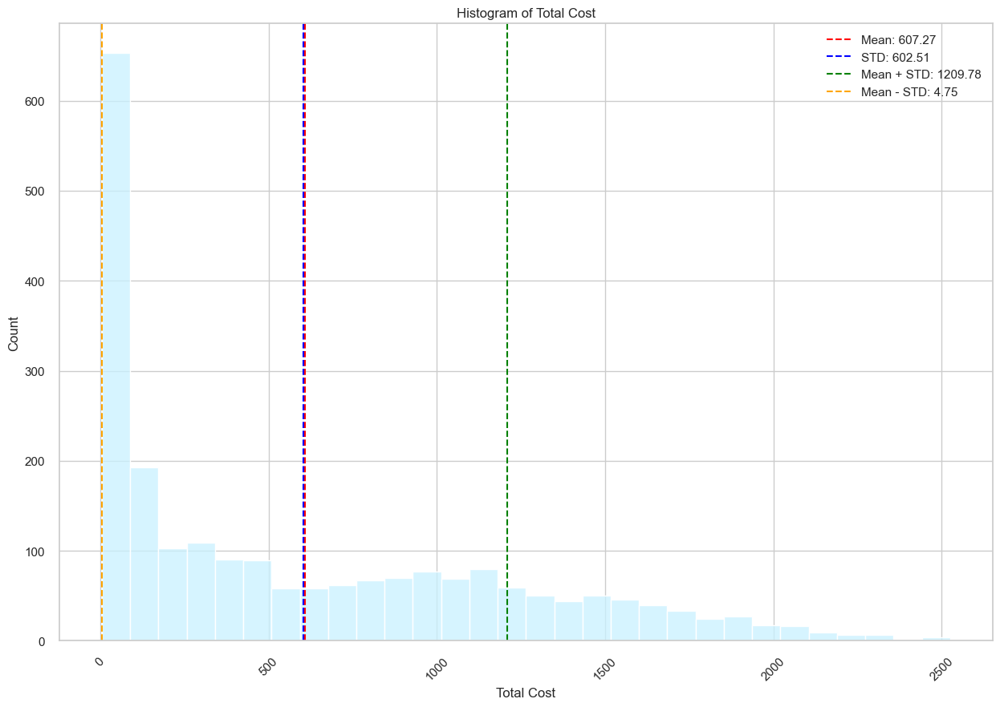

In [47]:
mean_cost = data_continuous['Total_Cost'].mean()  
std_cost = data_continuous['Total_Cost'].std()  

# Step 2: Create the histogram  
plt.figure(figsize=(15, 10))  
sns.histplot(x='Total_Cost', data=data_continuous, color='#C9F1FF', bins=30)  # Adjust bins as needed  
plt.title('Histogram of Total Cost')  
plt.xlabel('Total Cost')  
plt.ylabel('Count')  
plt.xticks(rotation=45)  

# Step 3: Add mean and STD to the legend  
plt.axvline(mean_cost, color='red', linestyle='--', label=f'Mean: {mean_cost:.2f}')  
plt.axvline(std_cost, color='blue', linestyle='--', label=f'STD: {std_cost:.2f}')  
plt.axvline(mean_cost + std_cost, color='green', linestyle='--', label=f'Mean + STD: {mean_cost + std_cost:.2f}')  
plt.axvline(mean_cost - std_cost, color='orange', linestyle='--', label=f'Mean - STD: {mean_cost - std_cost:.2f}')  

# Step 4: Show legend  
plt.legend()  

# Step 5: Show the plot  
plt.show()  


<div style="border-radius:10px; padding: 20px; background-color: #C9F1FF; font-size:120%; text-align:left">

<h3 align="left"><font color=black>Conclusion:</font></h3>

<h8 align="left"><font color=black></font></br>According to this plot, the customers of this store have purchased between 0 and 2500. Half of this range is 1250, and the people who have purchased more than this amount are the customers with large purchases, and the customers with less than 1250 are the customers with low purchases. On average, a total of 607.84 customers have bought from this store during these two years, and nearly 737 of the customers have not paid anything for the purchase, and the number of people with less purchases is more than those with more purchases. So the sales strategy of this store should focus on people who have bought less and become people who buy more. First, 100 customers who have made the most purchases are identified</font></h8>



In [48]:
top_customer=data_continuous[['Income','Total_Cost']].sort_values(by='Total_Cost',ascending=False).head(100)
top_customer

,Income,Total_Cost
1179,90638.00,2525
1572,90638.00,2525
1492,87679.00,2524
987,75759.00,2486
1052,69098.00,2440
...,...,...
111,68126.00,1820
497,78642.00,1816
1913,77870.00,1815
1190,78579.00,1812


<a id="products"></a>
# <b><span style='color:#215F9A'>Step 7.2 |</span><span style='color:black'>  Which products contribute most to sales, and which products are less popular? </span></b>

<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:115%; text-align:left">

To obtain the popularity of each product among customers, we acquire the most purchased products based on statistical analysis. First, we get the total sales of each product. Then we also calculate the total amount of purchases and divide the purchase amount of each product by the total amount of purchases and multiply by 100.

In [49]:
product_columns=['MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts',
       'MntSweetProducts', 'MntGoldProds']

In [50]:
total_sales = data_continuous[product_columns].sum()

In [51]:
total_sales

MntWines            675296
MntFruits            58241
MntMeatProducts     369470
MntFishProducts      83279
MntSweetProducts     59827
MntGoldProds         97164
dtype: int64

In [52]:
total_sales.sum()

1343277

In [53]:
total_sales_percentage=(total_sales/total_sales.sum())*100

In [54]:
total_sales_percentage

MntWines           50.27
MntFruits           4.34
MntMeatProducts    27.51
MntFishProducts     6.20
MntSweetProducts    4.45
MntGoldProds        7.23
dtype: float64

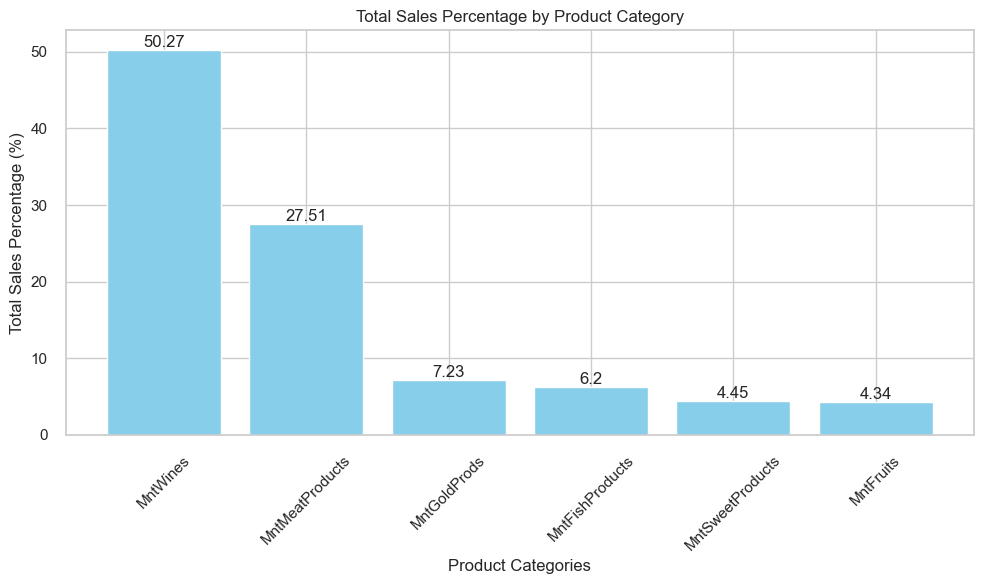

In [55]:


# Sort values in ascending order  
total_sales_percentage = total_sales_percentage.sort_values(ascending=False)  

# Create a bar plot  
plt.figure(figsize=(10, 6))  
bars = plt.bar(total_sales_percentage.index, total_sales_percentage, color='skyblue')  

# Add value labels on top of each bar  
for bar in bars:  
    yval = bar.get_height()  
    plt.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 2), ha='center', va='bottom')  

# Set labels and title  
plt.xlabel('Product Categories')  
plt.ylabel('Total Sales Percentage (%)')  
plt.title('Total Sales Percentage by Product Category')  
plt.xticks(rotation=45)  
plt.tight_layout()  

# Show the plot  
plt.show()

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">

<h3 align="left"><font color=#215F9A>Inference:</font></h3>
    

    
Overall, based on the plot above, wine has been the most popular among the customers of this store.

<a id="factors"></a>
# <b><span style='color:#215F9A'>Step 7.3 |</span><span style='color:black'>  What factors drive customers to make repeat purchases?  </span></b>

<div style="border-radius:10px; padding: 15px; background-color: #C9F1FF; font-size:115%; text-align:left">

One of the most important components in data analysis is checking the degree of correlation between data and it contains a lot of information. With this method, you can find the features that have the greatest impact on the number of times a customer purchases(Number_Purchases). To obtain the pattern between two features, the following two methods can be used:
1- Calculation of correlation
2- Scatter plot display of two featureIf the trend of the growing plot is linear, it means that these two characteristics are highly correlated.ted

In [56]:
Correlation_matrix=data_categorical.corr()
print(Correlation_matrix['Number_Purchases'].sort_values(ascending=False))

Number_Purchases       1.00
NumStorePurchases      0.82
NumWebPurchases        0.78
NumCatalogPurchases    0.74
NumDealsPurchases      0.36
Acceptance_Rate_Cmp    0.26
AcceptedCmp1           0.22
AcceptedCmp5           0.22
AcceptedCmp4           0.19
Response               0.16
Teenhome               0.13
Education              0.08
AcceptedCmp2           0.08
AcceptedCmp3           0.02
Marital_Status         0.01
Complain              -0.02
Year                  -0.18
NumWebVisitsMonth     -0.31
Kidhome               -0.48
Name: Number_Purchases, dtype: float64


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">

<h3 align="left"><font color=#215F9A>Inference:</font></h3>
    
- The `NumStorePurchases`  shows the greatest impact on the number time of purchases with a value of 0.82.
    
    
- The `NumWebPurchases`  shows a great impact on the number time of purchases with a value of 0.78.
    
    
- The `NumCatalogPurchases`  shows a great impact on the number time of purchases with a value of 0.74.  
    
____ 
    
Overall, `NumStorePurchases`, `NumWebPurchases`, and `NumCatalogPurchases` seem to have the most significant impact on the number of Purchases a customer because their correlation value is greater than 0.7 
    


In [57]:
data_continuous['Number_Purchases']=data_categorical['Number_Purchases']
Correlation_matrix=data_continuous.corr()
print(Correlation_matrix['Number_Purchases'].sort_values(ascending=False))

Number_Purchases       1.00
Total_Cost             0.76
Avg_Monthly_Purchase   0.76
MntWines               0.71
Income                 0.67
MntMeatProducts        0.57
MntGoldProds           0.49
MntSweetProducts       0.47
MntFishProducts        0.47
MntFruits              0.45
Age                    0.18
Recency                0.01
Name: Number_Purchases, dtype: float64


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">

<h3 align="left"><font color=#215F9A>Inference:</font></h3>
    
- The `Total_Cost` and `Avg_Monthly_Purchasenand`   show the greatest impact on the number time of purchases with a value of 0.76.
    
    
- The `MntWines`  shows a great impact on the number time of purchases with a value of 0.78.
    
    
- The `Income`  shows a great impact on the number time of purchases with a value of 0.71.  
    
____ 
    
Overall, `Total_Cost`, `Avg_Monthly_Purchasenand`, `MntWines`, and `Income` seem to have the most significant impact on the number of Purchases a customer because their correlation value is closer to  0.7. Also `Total_Cost`, `Avg_Monthly_Purchasenand` both display duplicate information, so one of them can be deleted.
    


<a id="correlation"></a>
# <b><span style='color:#215F9A'>Step 7.4 |</span><span style='color:black'>   Is there a correlation between customer income and their purchasing patterns?  </span></b>

In [58]:
Correlation_matrix=data_continuous.corr()
print(Correlation_matrix['Income'].sort_values(ascending=False))

Income                 1.00
Total_Cost             0.79
Avg_Monthly_Purchase   0.79
MntMeatProducts        0.69
MntWines               0.69
Number_Purchases       0.67
MntSweetProducts       0.52
MntFishProducts        0.52
MntFruits              0.51
MntGoldProds           0.39
Age                    0.20
Recency                0.01
Name: Income, dtype: float64


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">

<h3 align="left"><font color=#215F9A>Inference:</font></h3>
    
- The `Total_Cost` and `Avg_Monthly_Purchasenand`   show the greatest impact on the income and their purchasing patterns  with a value of 0.79.
    
    
- The `MntMeatProducts`  shows a great impact on the income and their purchasing pattern with a value of 0.69.
- - The `MntWines`  shows a great impact on the income and their purchasing pattern with a value of 0.69.
    
    
- The `Number_Purchases`  shows a great impact on the income and their purchasing pattern with a value of 0.67.  
    
____ 
    
Overall, `Total_Cost`, `Avg_Monthly_Purchasenand`, `MntMeatProducts`, and `Number_Purchases` seem to have the most significant impact on the income and their purchasing pattern of each customer because their correlation value is closer to  0.7. Also `Total_Cost`, `Avg_Monthly_Purchasenand` both display duplicate information, so one of them can be deleted.
    


In [59]:
data_categorical['Income']=data_continuous['Income']
Correlation_matrix=data_categorical.corr()
print(Correlation_matrix['Income'].sort_values(ascending=False))

Income                 1.00
NumCatalogPurchases    0.70
Number_Purchases       0.67
NumStorePurchases      0.63
NumWebPurchases        0.46
AcceptedCmp5           0.40
Acceptance_Rate_Cmp    0.37
AcceptedCmp1           0.33
AcceptedCmp4           0.22
Response               0.16
Education              0.13
AcceptedCmp2           0.10
Teenhome               0.03
Year                   0.03
Marital_Status        -0.00
AcceptedCmp3          -0.02
Complain              -0.03
NumDealsPurchases     -0.11
Kidhome               -0.51
NumWebVisitsMonth     -0.65
Name: Income, dtype: float64


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">

<h3 align="left"><font color=#215F9A>Inference:</font></h3>
    
- The `NumCatalogPurchases` shows the greatest impact on the income and their purchasing patterns  with a value of 0.70.
    
    
- The `Number_Purchases`  shows a great impact on the income and their purchasing pattern with a value of 0.67.
- The `NumStorePurchases`  shows a great impact on the income and their purchasing pattern with a value of 0.63.
- The `NumWebVisitsMonth `  shows the opposite impact on the income and their purchasing pattern with a value of -0.65. It means customers who have more income visit the site less.
       
____ 
    
Overall, `NumCatalogPurchases`, `Number_Purchases`, and `NumStorePurchases` seem to have the most significant impact on the income and their purchasing pattern of each customer because their correlation value is closer to  0.7. 


<a id="website"></a>
# <b><span style='color:#215F9A'>Step 7.5 |</span><span style='color:black'>    Are customers who visit the website more frequently more likely to make purchases?  </span></b>

In [60]:
data_continuous['NumWebVisitsMonth']=data_categorical['NumWebVisitsMonth']
Correlation=data_continuous[['NumWebVisitsMonth','Total_Cost']].corr()
print(Correlation)

                   NumWebVisitsMonth  Total_Cost
NumWebVisitsMonth               1.00       -0.50
Total_Cost                     -0.50        1.00


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">

<h3 align="left"><font color=#215F9A>Inference:</font></h3>
These two features `NumWebVisitsMonth`, and `Total_Cost` have very little correlation

Text(0.5, 1.0, 'NumWebVisitsMonth Vs Total_Cost')

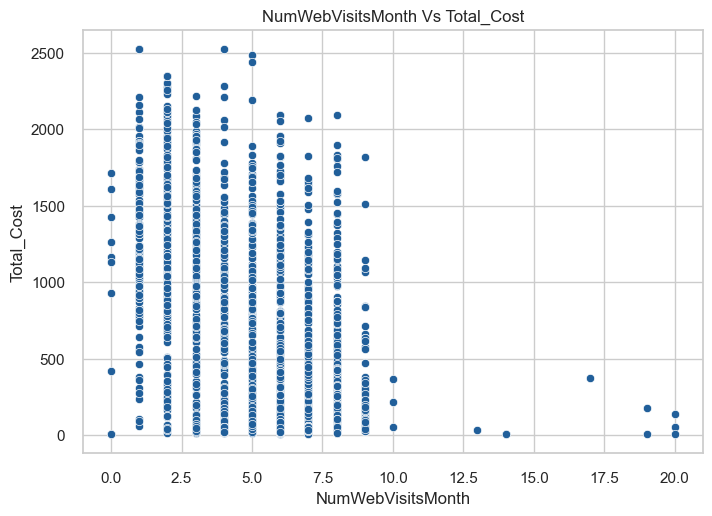

In [61]:
sns.scatterplot(x='NumWebVisitsMonth',y='Total_Cost',data=data_continuous,color='#215F9A')
plt.title('NumWebVisitsMonth Vs Total_Cost')

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">

<h3 align="left"><font color=#215F9A>Inference:</font></h3>
The correlation coefficient between NumWebVisitsMonth and Total_Cost is approximately -0.10. This indicates a very weak negative correlation between the number of web visits per month and the total cost. In practical terms, this suggests that there is no significant linear relationship between these two variables—changes in the number of web visits do not strongly predict changes in total cost, and any observed association is likely very weak or influenced by other factors.

<a id="accepted"></a>
# <b><span style='color:#215F9A'>Step 7.6 |</span><span style='color:black'>  What characteristics do customers who have accepted campaigns share?  </span></b>

In [62]:
data_categorical.iloc[:,9:16]

,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
0,0,0,0,0,0,0,1
1,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...
2235,0,0,0,0,0,0,0
2236,0,0,0,1,0,0,0
2237,0,1,0,0,0,0,0
2238,0,0,0,0,0,0,0


<Axes: >

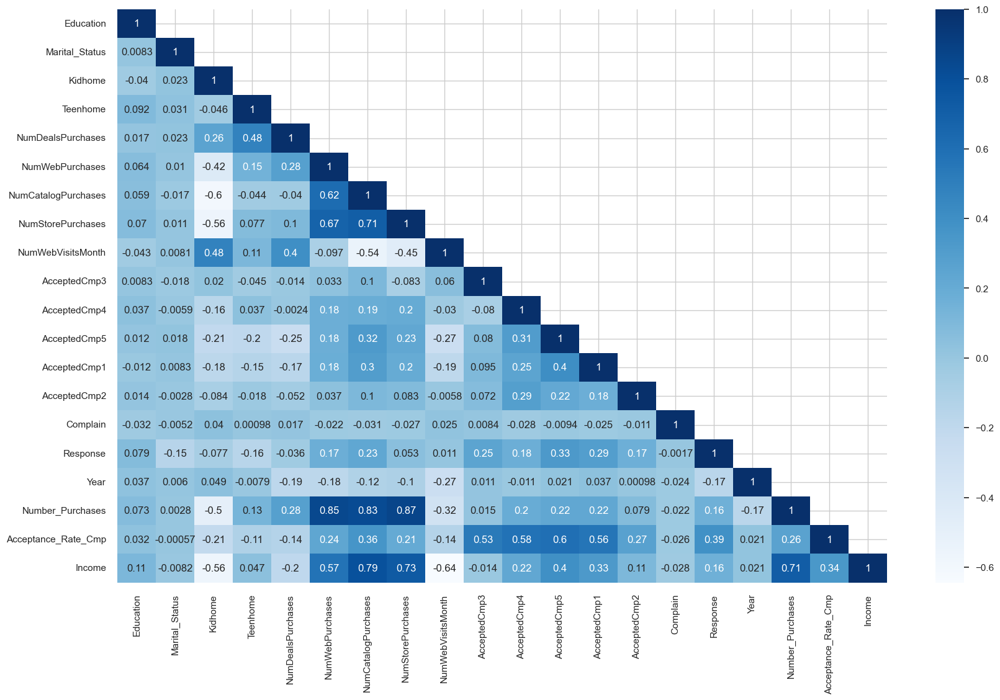

In [63]:
corr=data_categorical.corr(method='spearman')
fig,ax=plt.subplots(figsize=(20,12))

mask=np.zeros_like(corr)
mask[np.triu_indices_from(mask,1)]=True
sns.heatmap(corr,cmap='Blues',mask=mask,annot=True,ax=ax)


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">

<h3 align="left"><font color=#215F9A>Inference:</font></h3>
According to the correlation chart, there is not much correlation between the response and the acceptance of the campaigns, in the event that these features must be directly related to each other, and by checking the dataset and the response column when entering information, sometimes the value of the response column is not entered correctly. So, in the feature engineering process, we re-enter the response column information as follows. That is, if the customer has accepted one of the five campaigns, the value of the response column will be equal to 1.

In [64]:
data_categorical['Total_Accepted_Campaigns']=data_categorical[['AcceptedCmp3','AcceptedCmp4','AcceptedCmp5','AcceptedCmp1','AcceptedCmp2']].sum(axis=1)  
data_categorical.loc[data_categorical['Total_Accepted_Campaigns']==0,'Response']=0
data_categorical.loc[data_categorical['Total_Accepted_Campaigns']>0,'Response']=1
data_categorical.drop('Total_Accepted_Campaigns',axis=1,inplace=True)

<Axes: >

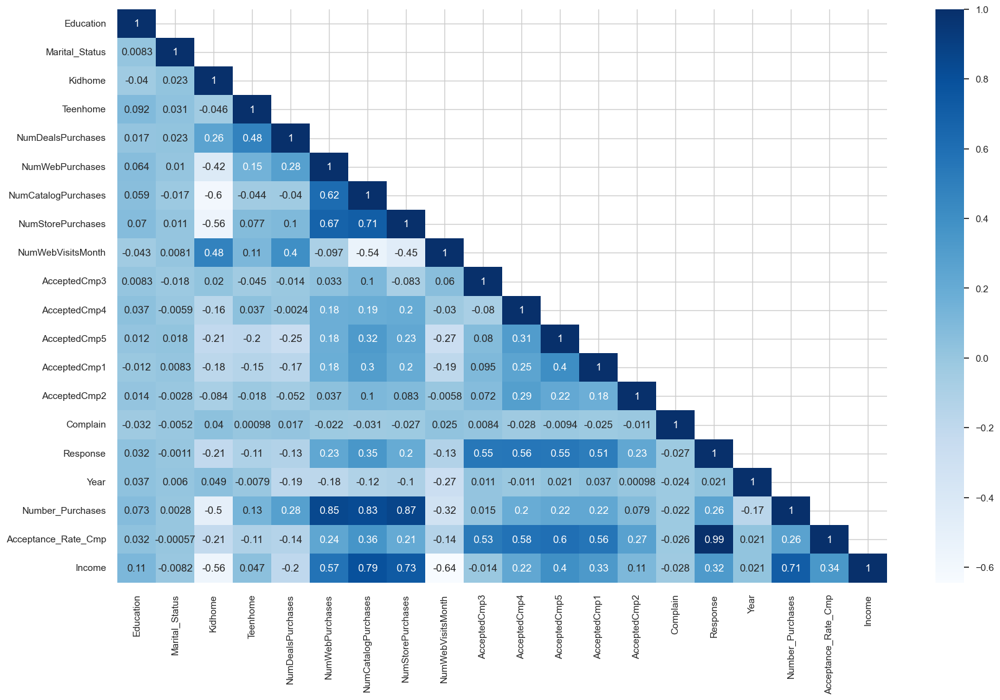

In [65]:
corr=data_categorical.corr(method='spearman')
fig,ax=plt.subplots(figsize=(20,12))

mask=np.zeros_like(corr)
mask[np.triu_indices_from(mask,1)]=True
sns.heatmap(corr,cmap='Blues',mask=mask,annot=True,ax=ax)


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">

After correcting the information of the response column, it can be seen that the correlation of the campaign acceptance columns with the response column has increased greatly.

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
Now, by showing the scatter plot from the response column and all the characteristics of the dataset, you can find out what characteristics those who have accepted the campaigns or not have.

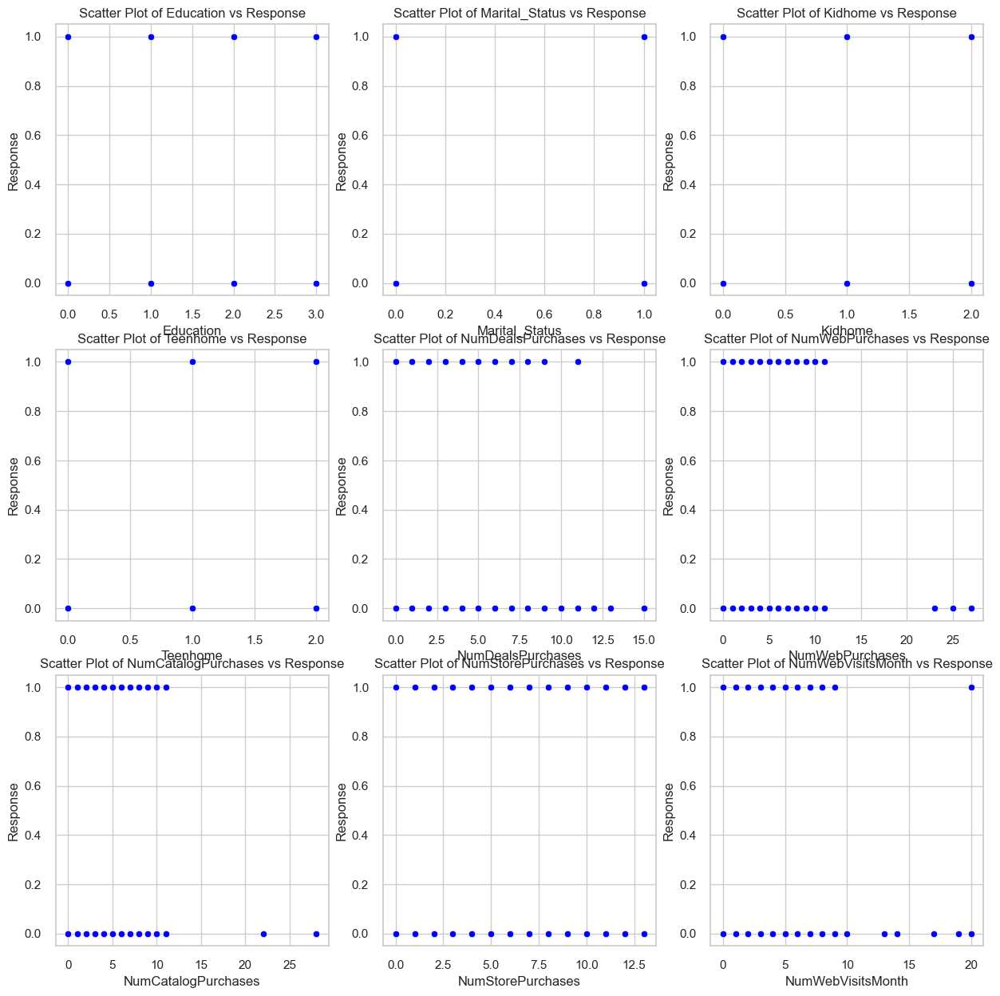

In [66]:
fig, axes = plt.subplots(3, 3, figsize=(15, 15))  
features = ['Education', 'Marital_Status', 'Kidhome', 'Teenhome',  
            'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',  
            'NumStorePurchases', 'NumWebVisitsMonth']  

# Create scatter plots for each feature against the Response  
for ax, feature in zip(axes.flatten(), features):  
    sns.scatterplot(data=data_categorical, x=feature, y='Response', ax=ax, color='blue')  
    ax.set_title(f'Scatter Plot of {feature} vs Response')  
    ax.set_xlabel(feature)  
    ax.set_ylabel('Response') 

In [67]:
data_continuous['Response']=data_categorical['Response']


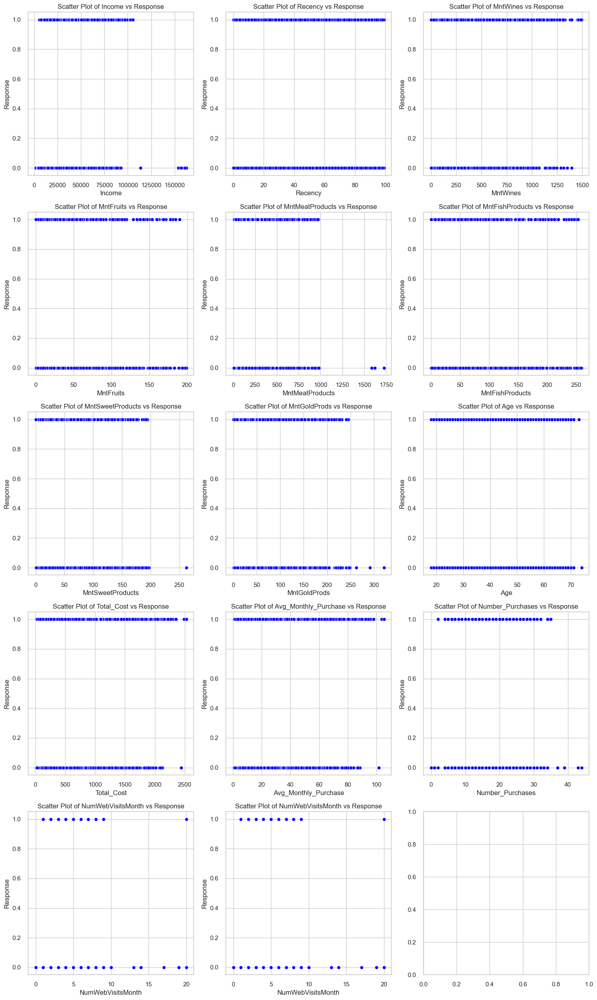

In [68]:
# Set up the matplotlib figure with 5 rows and 3 columns  
fig, axes = plt.subplots(5, 3, figsize=(15, 25))  # Adjust height for better aspect ratio  
features = ['Income', 'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',  
            'MntFishProducts', 'MntSweetProducts', 'MntGoldProds', 'Age',  
            'Total_Cost', 'Avg_Monthly_Purchase', 'Number_Purchases',  
            'NumWebVisitsMonth', 'NumWebVisitsMonth']  

# Create scatter plots for each feature against the Response  
for ax, feature in zip(axes.flatten(), features):  
    sns.scatterplot(data=data_continuous, x=feature, y='Response', ax=ax, color='blue')  
    ax.set_title(f'Scatter Plot of {feature} vs Response')  
    ax.set_xlabel(feature)  
    ax.set_ylabel('Response')  

# Adjust the spacing between plots  
plt.subplots_adjust(hspace=0.5, wspace=0.4)  # Increase values for more space  

plt.tight_layout()  # Optional: handle layout for overlap issues  
plt.show()  

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
<h3 align="left"><font color=#215F9A>Inference:</font></h3>
Those who bought more meat and wine also accepted more campaigns, and those who shopped more in-store also accepted more campaigns.Customers who accept campaigns visit the site less often.

<a id="subsequent"></a>
# <b><span style='color:#215F9A'>Step 7.7 |</span><span style='color:black'>  Are customers who have been successful in one campaign likely to accept subsequent ones?  </span></b>

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
If the correlation between campaigns is positive, then it is more likely that the customer will accept future campaigns

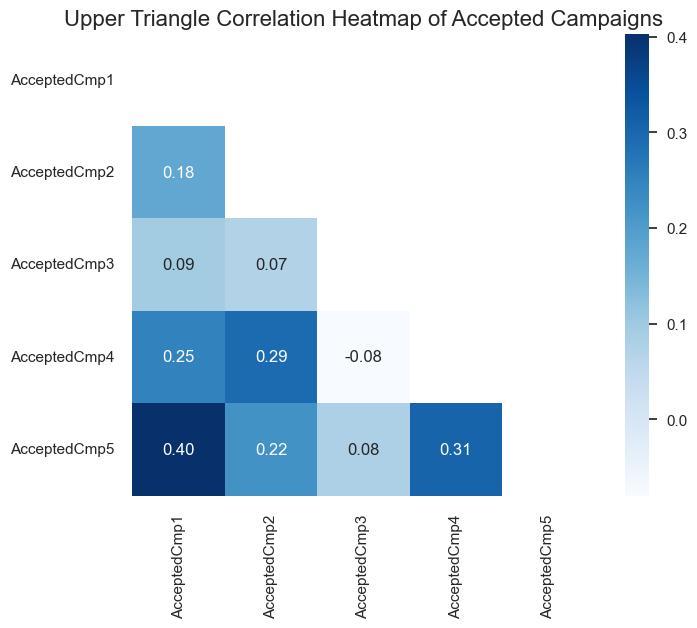

In [69]:
# Define the columns to analyze  
columns_of_interest = ['AcceptedCmp1', 'AcceptedCmp2', 'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5']  

# Calculate the correlation matrix  
correlation_matrix = data_categorical[columns_of_interest].corr()  

# Set up the matplotlib figure 

fig, ax = plt.subplots(figsize=(8, 6))

# Create a mask for the upper triangle  
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))  

# Create the heatmap with the mask  
sns.heatmap(correlation_matrix, annot=True, fmt=".2f",ax=ax, cmap='Blues', cbar=True, square=True, linecolor='white', linewidths=0,  
             mask=mask)  
ax.grid(False)
# Set title  
plt.title('Upper Triangle Correlation Heatmap of Accepted Campaigns', fontsize=16)  
plt.show()  

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
There is a higher correlation between the customers who accepted campaign 1 and 4 than the customers who accepted campaign 5.

<a id="frequently"></a>
# <b><span style='color:#215F9A'>Step 7.8 |</span><span style='color:black'>  Do customers who purchase more frequently accept campaigns more often?  </span></b>

In [70]:
data_categorical['Total_Cost']=data_continuous['Total_Cost']
Correlation_matrix=data_categorical.corr()
print(Correlation_matrix['Total_Cost'].sort_values(ascending=False))

Total_Cost             1.00
Income                 0.79
NumCatalogPurchases    0.78
Number_Purchases       0.76
NumStorePurchases      0.68
NumWebPurchases        0.53
AcceptedCmp5           0.47
Acceptance_Rate_Cmp    0.46
Response               0.41
AcceptedCmp1           0.38
AcceptedCmp4           0.25
AcceptedCmp2           0.14
Education              0.06
AcceptedCmp3           0.05
Marital_Status        -0.02
Complain              -0.03
NumDealsPurchases     -0.07
Teenhome              -0.14
Year                  -0.14
NumWebVisitsMonth     -0.50
Kidhome               -0.56
Name: Total_Cost, dtype: float64


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
There is little correlation between customers who made high purchases and accepting the campaign.


<a id="rates"></a>
# <b><span style='color:#215F9A'>Step 7.9 |</span><span style='color:black'>  Does the timing or frequency of campaigns affect acceptance rates?  </span></b>

<a id="reject"></a>
# <b><span style='color:#215F9A'>Step 7.10 |</span><span style='color:black'>  What factors cause customers to reject campaigns?  </span></b>

In [71]:
Correlation_with_Response=data_categorical.corr()['Response'].sort_values(ascending=False)
print(Correlation_with_Response)

Response               1.00
Acceptance_Rate_Cmp    0.86
AcceptedCmp4           0.56
AcceptedCmp3           0.55
AcceptedCmp5           0.55
AcceptedCmp1           0.51
Total_Cost             0.41
Income                 0.31
NumCatalogPurchases    0.31
Number_Purchases       0.25
AcceptedCmp2           0.23
NumWebPurchases        0.21
NumStorePurchases      0.19
Education              0.04
Year                   0.02
Marital_Status        -0.00
Complain              -0.03
NumDealsPurchases     -0.09
Teenhome              -0.10
NumWebVisitsMonth     -0.13
Kidhome               -0.20
Name: Response, dtype: float64


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
There is no special feature that has much correlation with accepting or rejecting campaigns

<a id="Deleting"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 8: Deleting columns created in the analysis </p>

⬆️[Tabel of Contents](#contents_tabel)

In [72]:
data_categorical=data_categorical.drop(['Income'],axis=1)
data_categorical.describe().T

,count,mean,std,min,25%,50%,75%,max
Education,2240.00,1.67,0.84,0.00,1.00,1.00,2.00,3.00
Marital_Status,2240.00,0.64,0.48,0.00,0.00,1.00,1.00,1.00
Kidhome,2240.00,0.44,0.54,0.00,0.00,0.00,1.00,2.00
Teenhome,2240.00,0.51,0.54,0.00,0.00,0.00,1.00,2.00
NumDealsPurchases,2240.00,2.33,1.93,0.00,1.00,2.00,3.00,15.00
NumWebPurchases,2240.00,4.08,2.78,0.00,2.00,4.00,6.00,27.00
NumCatalogPurchases,2240.00,2.66,2.92,0.00,0.00,2.00,4.00,28.00
NumStorePurchases,2240.00,5.79,3.25,0.00,3.00,5.00,8.00,13.00
NumWebVisitsMonth,2240.00,5.32,2.43,0.00,3.00,6.00,7.00,20.00
AcceptedCmp3,2240.00,0.07,0.26,0.00,0.00,0.00,0.00,1.00


In [73]:
columns_to_drop = ['Avg_Monthly_Purchase', 'Response', 'NumWebVisitsMonth', 'Total_Cost']  
data_continuous = data_continuous.drop(columns=columns_to_drop, axis=1)  
data_continuous.describe().T

,count,mean,std,min,25%,50%,75%,max
Income,2212.00,51958.81,21527.28,1730.00,35233.50,51371.00,68487.00,162397.00
Recency,2212.00,49.02,28.94,0.00,24.00,49.00,74.00,99.00
MntWines,2212.00,305.29,337.32,0.00,24.00,175.50,505.00,1493.00
MntFruits,2212.00,26.33,39.74,0.00,2.00,8.00,33.00,199.00
MntMeatProducts,2212.00,167.03,224.25,0.00,16.00,68.00,232.25,1725.00
MntFishProducts,2212.00,37.65,54.77,0.00,3.00,12.00,50.00,259.00
MntSweetProducts,2212.00,27.05,41.09,0.00,1.00,8.00,33.00,262.00
MntGoldProds,2212.00,43.93,51.71,0.00,9.00,24.50,56.00,321.00
Age,2212.00,45.09,11.70,18.00,37.00,44.00,55.00,74.00
Number_Purchases,2212.00,14.89,7.67,0.00,8.00,15.00,21.00,44.00


In [74]:
data_final=pd.concat([data_continuous,data_categorical],axis=1)


In [75]:
data_final.describe().T

,count,mean,std,min,25%,50%,75%,max
Income,2212.00,51958.81,21527.28,1730.00,35233.50,51371.00,68487.00,162397.00
Recency,2212.00,49.02,28.94,0.00,24.00,49.00,74.00,99.00
MntWines,2212.00,305.29,337.32,0.00,24.00,175.50,505.00,1493.00
MntFruits,2212.00,26.33,39.74,0.00,2.00,8.00,33.00,199.00
MntMeatProducts,2212.00,167.03,224.25,0.00,16.00,68.00,232.25,1725.00
MntFishProducts,2212.00,37.65,54.77,0.00,3.00,12.00,50.00,259.00
MntSweetProducts,2212.00,27.05,41.09,0.00,1.00,8.00,33.00,262.00
MntGoldProds,2212.00,43.93,51.71,0.00,9.00,24.50,56.00,321.00
Age,2212.00,45.09,11.70,18.00,37.00,44.00,55.00,74.00
Number_Purchases,2212.00,14.89,7.67,0.00,8.00,15.00,21.00,44.00


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
Because the number of categorical and continuous data is not equal, we have some missing values ​​in the final dataset that should be removed.

In [76]:
data_final=data_final.dropna()

In [77]:
data_final.describe().T

,count,mean,std,min,25%,50%,75%,max
Income,2212.00,51958.81,21527.28,1730.00,35233.50,51371.00,68487.00,162397.00
Recency,2212.00,49.02,28.94,0.00,24.00,49.00,74.00,99.00
MntWines,2212.00,305.29,337.32,0.00,24.00,175.50,505.00,1493.00
MntFruits,2212.00,26.33,39.74,0.00,2.00,8.00,33.00,199.00
MntMeatProducts,2212.00,167.03,224.25,0.00,16.00,68.00,232.25,1725.00
MntFishProducts,2212.00,37.65,54.77,0.00,3.00,12.00,50.00,259.00
MntSweetProducts,2212.00,27.05,41.09,0.00,1.00,8.00,33.00,262.00
MntGoldProds,2212.00,43.93,51.71,0.00,9.00,24.50,56.00,321.00
Age,2212.00,45.09,11.70,18.00,37.00,44.00,55.00,74.00
Number_Purchases,2212.00,14.89,7.67,0.00,8.00,15.00,21.00,44.00


<a id="Scaling"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 9: Feature Scaling </p>

⬆️[Tabel of Contents](#contents_tabel)

In [78]:
scaler=StandardScaler()
data_final_scale=pd.DataFrame(scaler.fit_transform(data_final),columns=data_final.columns)
data_final_scale.head(10)

,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,Age,Number_Purchases,...,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Year,Number_Purchases,Acceptance_Rate_Cmp,Total_Cost
0,0.29,0.31,0.98,1.55,1.69,2.45,1.48,0.85,1.02,1.32,...,-0.28,-0.28,-0.26,-0.12,-0.10,-0.51,-1.50,1.32,-0.44,1.68
1,-0.26,-0.38,-0.87,-0.64,-0.72,-0.65,-0.63,-0.73,1.27,-1.16,...,-0.28,-0.28,-0.26,-0.12,-0.10,-0.51,1.42,-1.16,-0.44,-0.96
2,0.91,-0.80,0.36,0.57,-0.18,1.34,-0.15,-0.04,0.33,0.80,...,-0.28,-0.28,-0.26,-0.12,-0.10,-0.51,-0.04,0.80,-0.44,0.28
3,-1.18,-0.80,-0.87,-0.56,-0.66,-0.50,-0.59,-0.75,-1.29,-0.90,...,-0.28,-0.28,-0.26,-0.12,-0.10,-0.51,1.42,-0.90,-0.44,-0.92
4,0.29,1.55,-0.39,0.42,-0.22,0.15,-0.00,-0.56,-1.03,0.54,...,-0.28,-0.28,-0.26,-0.12,-0.10,-0.51,1.42,0.54,-0.44,-0.31
5,0.49,-1.14,0.64,0.39,-0.31,-0.69,0.36,-0.58,0.16,0.93,...,-0.28,-0.28,-0.26,-0.12,-0.10,-0.51,-0.04,0.93,-0.44,0.18
6,0.17,-0.52,-0.21,0.97,-0.01,0.23,0.53,-0.33,-0.18,0.80,...,-0.28,-0.28,-0.26,-0.12,-0.10,-0.51,-1.50,0.80,-0.44,-0.03
7,-0.86,-0.59,-0.68,-0.41,-0.50,-0.63,-0.63,-0.40,-1.38,-0.64,...,-0.28,-0.28,-0.26,-0.12,-0.10,-0.51,-0.04,-0.64,-0.44,-0.73
8,-1.00,-1.04,-0.86,-0.66,-0.64,-0.63,-0.59,-0.81,-0.43,-1.16,...,-0.28,-0.28,-0.26,-0.12,-0.10,-0.51,-0.04,-1.16,-0.44,-0.93
9,-2.15,0.66,-0.82,-0.66,-0.72,-0.67,-0.63,-0.60,1.62,-1.68,...,-0.28,-0.28,-0.26,-0.12,-0.10,1.96,1.42,-1.68,1.03,-0.93


In [79]:
data_final_scale.describe().T

,count,mean,std,min,25%,50%,75%,max
Income,2212.00,-0.00,1.00,-2.33,-0.78,-0.03,0.77,5.13
Recency,2212.00,0.00,1.00,-1.69,-0.86,-0.00,0.86,1.73
MntWines,2212.00,0.00,1.00,-0.91,-0.83,-0.38,0.59,3.52
MntFruits,2212.00,0.00,1.00,-0.66,-0.61,-0.46,0.17,4.35
MntMeatProducts,2212.00,0.00,1.00,-0.74,-0.67,-0.44,0.29,6.95
MntFishProducts,2212.00,-0.00,1.00,-0.69,-0.63,-0.47,0.23,4.04
MntSweetProducts,2212.00,0.00,1.00,-0.66,-0.63,-0.46,0.14,5.72
MntGoldProds,2212.00,0.00,1.00,-0.85,-0.68,-0.38,0.23,5.36
Age,2212.00,0.00,1.00,-2.32,-0.69,-0.09,0.85,2.47
Number_Purchases,2212.00,-0.00,1.00,-1.94,-0.90,0.01,0.80,3.80


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
<h3 align="left"><font color=#215F9A>Inference:</font></h3>
In summary, applying StandardScaler (or any other normalization technique) before running PCA ensures that the principal components reflect the patterns and relationships inherent in the data rather than being influenced by the original scales of the features. This results in a more accurate and meaningful representation of the data's structure and variance. Therefore, standardizing is essential for fair and unbiased analysis with PCA.

<a id="PCA"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 10: Dimensionality Reduction (PCA) </p>

⬆️[Tabel of Contents](#contents_tabel)


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
Now it is possible to reduce the dimensions of the dataset and get some of the most effective features from among 30 features. In reducing the dimensions of clustering data, feature extraction is used, which is one of the techniques of PCA, which we will perform in order in the following steps.

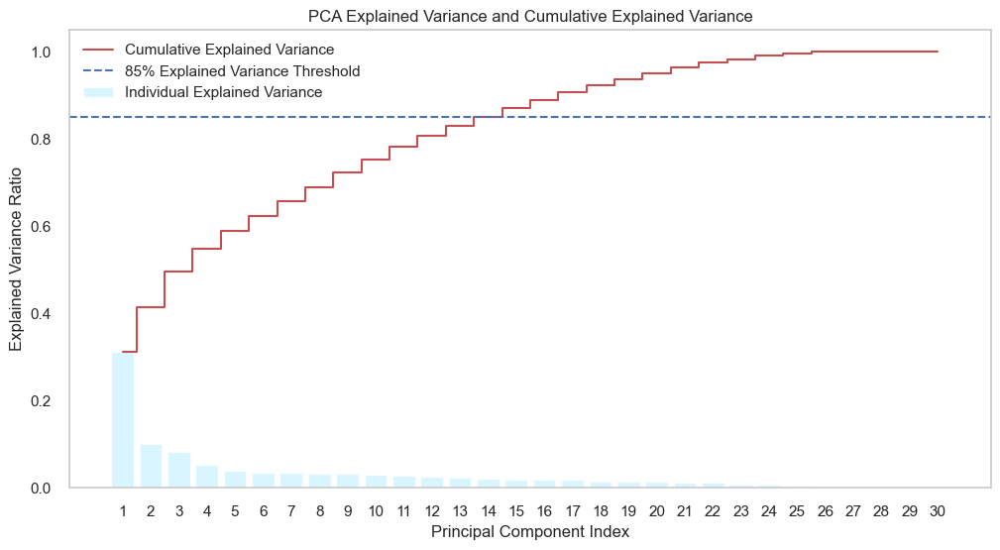

Optimal number of components (k) for 85.0% explained variance: 14


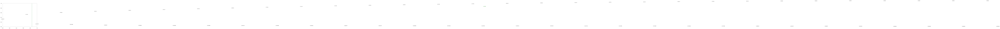

In [80]:
# Step 2: PCA  
pca = PCA()  
pca.fit(data_final_scale)  


# Step 3: Explained variance and cumulative explained variance  
explained_variance = pca.explained_variance_ratio_  
cumulative_explained_variance = np.cumsum(explained_variance)  

# Step 4: Plotting Explained Variance and Cumulative Explained Variance  
plt.figure(figsize=(12, 6))  
plt.bar(range(1, len(explained_variance) + 1), explained_variance, alpha=0.7, color='#C9F1FF', label='Individual Explained Variance')  
plt.step(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, where='mid', label='Cumulative Explained Variance', color='r')  
plt.ylabel('Explained Variance Ratio')  
plt.xlabel('Principal Component Index')  
plt.title('PCA Explained Variance and Cumulative Explained Variance')  
plt.xticks(range(1, len(explained_variance) + 1))  

# Adding a threshold line (e.g., 0.85 for 85%)  
threshold = 0.85  
plt.axhline(y=threshold, color='b', linestyle='--', label='85% Explained Variance Threshold')  
plt.legend(loc='best')  
plt.grid()  
plt.show()  

# Step 5: Determine optimal k for the explained variance threshold  
def optimal_components(explained_variance, threshold=0.85):  
    """ Return the number of components required to meet the explained variance threshold. """  
    cumulative_explained_variance = np.cumsum(explained_variance)  
    k = np.argmax(cumulative_explained_variance >= threshold) + 1  # Add 1 for the index  
    return k  

# Calculate optimal number of components based on the desired threshold  
optimal_k = optimal_components(explained_variance, threshold)  
print(f"Optimal number of components (k) for {threshold * 100}% explained variance: {optimal_k}")  

# Annotate the optimal k on the plot  
plt.text(optimal_k, cumulative_explained_variance[optimal_k - 1], f'  k={optimal_k}', color='green', verticalalignment='bottom') 
# Add a vertical line for the optimal k  
plt.axvline(x=cumulative_explained_variance[optimal_k - 1], color='g', linestyle='--', label=f'Optimal k = {optimal_k}') 

x_offset=-0.3
y_offset=0.1
for i,(ev_ratio,cum_ev_ratio) in enumerate(zip(explained_variance,cumulative_explained_variance)):
    plt.text(i,ev_ratio,f"{ev_ratio:2f}",ha='center',va='bottom',fontsize=10)
    if i>0:
        plt.text(i+x_offset,cum_ev_ratio+y_offset,f"{cum_ev_ratio:2f}",ha='center',va='bottom',fontsize=8)
plt.grid(axis='both')        
plt.show()


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
<h3 align="left"><font color=#215F9A>Inference:</font></h3>
This plot shows how much variance each feature has and according to it, if we keep 14 features, we actually have 85% of the information. We choose the number of features to be 15 to avoid the complexity and overfitting of the model and to keep 90% of the dataset information.

In [81]:
pca=PCA(n_components=15)
customer_data_pca=pca.fit_transform(data_final_scale)

customer_data_pca=pd.DataFrame(customer_data_pca,columns=['PC'+str(i+1) for i in range(pca.n_components)])

                                   
customer_data_pca.index=data_final_scale.index

In [82]:
customer_data_pca

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15
0,4.03,-2.27,-0.81,1.98,0.37,0.68,-1.59,0.17,-0.01,-0.83,-0.64,1.10,0.20,-0.72,0.81
1,-3.12,0.30,-0.43,-1.51,-0.73,1.05,-0.79,-0.73,0.52,1.05,-0.63,0.86,0.65,-0.07,-0.19
2,1.76,-1.42,-0.72,-0.01,0.18,-0.16,0.66,-0.89,0.75,-0.48,0.38,-1.05,-0.60,0.09,0.73
3,-3.19,0.66,-1.10,0.41,0.31,-0.76,1.12,-0.75,0.44,1.07,0.40,-0.48,-0.01,0.14,0.24
4,-0.29,-0.88,0.03,-0.06,0.32,-1.35,1.01,1.24,-1.60,1.99,0.69,0.27,-0.99,-0.42,-0.03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2207,2.48,-1.83,-0.04,0.98,-0.53,1.36,0.47,-1.41,-0.14,-0.94,0.35,-0.43,-1.02,1.59,-1.72
2208,0.39,1.27,3.82,-0.90,-1.09,-0.95,1.74,0.31,-0.75,2.20,-2.39,2.78,-1.86,0.65,1.30
2209,2.38,2.09,0.40,-0.51,1.74,0.72,-1.27,0.17,-0.49,1.85,0.26,-3.16,0.23,-1.54,0.87
2210,2.06,-1.77,0.11,-1.86,-1.04,-0.50,0.91,-0.97,0.96,0.25,0.46,-0.18,-0.06,0.20,0.25


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
The new dataset is made with 15 features, and the name of each feature changes from PCA1 to PCA15 but the number of rows does not change.

<a id="KMeans"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 11: K_Means Clustering </p>

⬆️[Tabel of Contents](#contents_tabel)


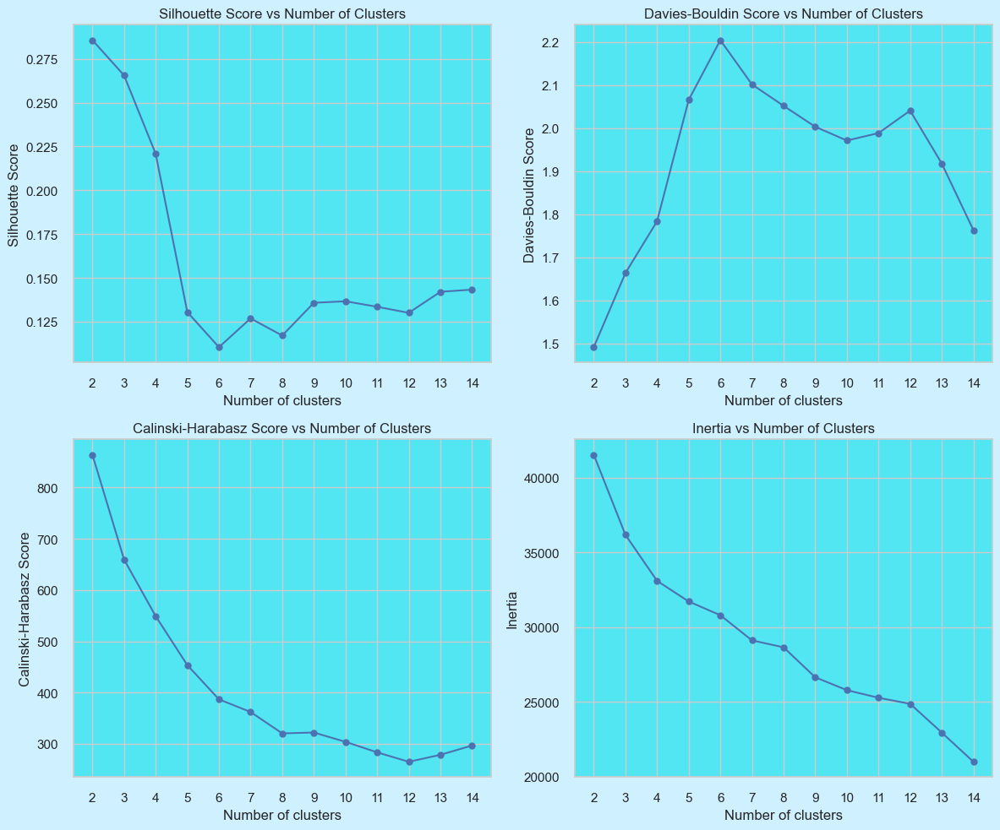

In [83]:




# Set face colors for the plots  
plt.rcParams['axes.facecolor'] = '#51E6F2'  
plt.rcParams['figure.facecolor'] = '#CFF1FF'  

# Create subplots  
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12, 10))  

# Calculate the Silhouette Score  
silhouette_list = []  
for k in range(2, 15):  
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=0)  
    y_pred = kmeans.fit_predict(customer_data_pca)  
    s = silhouette_score(customer_data_pca, y_pred)   
    silhouette_list.append(s)  

# Silhouette Score Plot  
axes[0, 0].plot(range(2, 15), silhouette_list, marker='o')  
axes[0, 0].set_xticks(range(2, 15))  
axes[0, 0].set_xlabel('Number of clusters')  
axes[0, 0].set_ylabel('Silhouette Score')  
axes[0, 0].set_title('Silhouette Score vs Number of Clusters')  

# Calculate Davies-Bouldin Score  
davies_list = []  
for k in range(2, 15):  
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=0)  
    y_pred = kmeans.fit_predict(customer_data_pca)  
    db = davies_bouldin_score(customer_data_pca, y_pred)   
    davies_list.append(db)  

# Davies-Bouldin Score Plot (lower is better)  
axes[0, 1].plot(range(2, 15), davies_list, marker='o')  
axes[0, 1].set_xticks(range(2, 15))  
axes[0, 1].set_xlabel('Number of clusters')   
axes[0, 1].set_ylabel('Davies-Bouldin Score')  
axes[0, 1].set_title('Davies-Bouldin Score vs Number of Clusters')  

# Calculate Calinski-Harabasz Score  
calinski_list = []  
for k in range(2, 15):  # Use the same range for consistency  
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=0)  
    y_pred = kmeans.fit_predict(customer_data_pca)  
    ch = calinski_harabasz_score(customer_data_pca, y_pred)  
    calinski_list.append(ch)  

# Calinski-Harabasz Score Plot   
axes[1, 0].plot(range(2, 15), calinski_list, marker='o')  
axes[1, 0].set_xticks(range(2, 15))  
axes[1, 0].set_xlabel('Number of clusters')   
axes[1, 0].set_ylabel('Calinski-Harabasz Score')  
axes[1, 0].set_title('Calinski-Harabasz Score vs Number of Clusters')  

# Calculate Inertia (inertia is already part of the KMeans object)  
inertia_list = []  
for k in range(2, 15):  
    kmeans = KMeans(n_clusters=k, init='k-means++', random_state=0)  
    y_pred = kmeans.fit_predict(customer_data_pca)  
    inertia_list.append(kmeans.inertia_)  # Inertia collected correctly  

# Inertia Plot   
axes[1, 1].plot(range(2, 15), inertia_list, marker='o')  
axes[1, 1].set_xticks(range(2, 15))  
axes[1, 1].set_xlabel('Number of clusters')   
axes[1, 1].set_ylabel('Inertia')  
axes[1, 1].set_title('Inertia vs Number of Clusters')  

# Adjust layout  
plt.tight_layout()  
plt.show()

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
<h3 align="left"><font color=#215F9A>Inference:</font></h3>
Here we determine the best number of clusters for the data set in 4 ways
</br><b>1:Silhouette_Score</b> The higher the silhouette score value, the better the model is, and we choose the first value that is the highest in the silhouette plot. <b>(  best number of clusster in silhouette score = 2)</b>
</br><b>2:Davies-Bouldin_Score</b> The lower the silhouette score value, the better the model is, and we choose the first value that is the lowest in the Davies-Bouldin plot. <b>(  best number of clusster in Davies-Bouldin_Score =2)</b>
</br><b>3:Calinski_Harabasz_Score</b> The higher the Calinski_Harabasz_Score value, the better the model is, and we choose the first value that is the highest in the Calinski_Harabasz plot. <b>(  best number of clusster in Calinski_Harabasz_Score = 2)</b>
</br><b>4:Inertia</b> The lower the Inertia value, the better the model is, and we choose the first value that is the lowest in the Inertia plot. <b>(  best number of clusster in Inertia = 3)</b>

<a id="SilhouetteVisualizer"></a>
# <b><span style='color:#215F9A'>Step 11.2 |</span><span style='color:black'>  Choosing the optimal number of clusters using silhouette analysis in KMeans clustering.  </span></b>


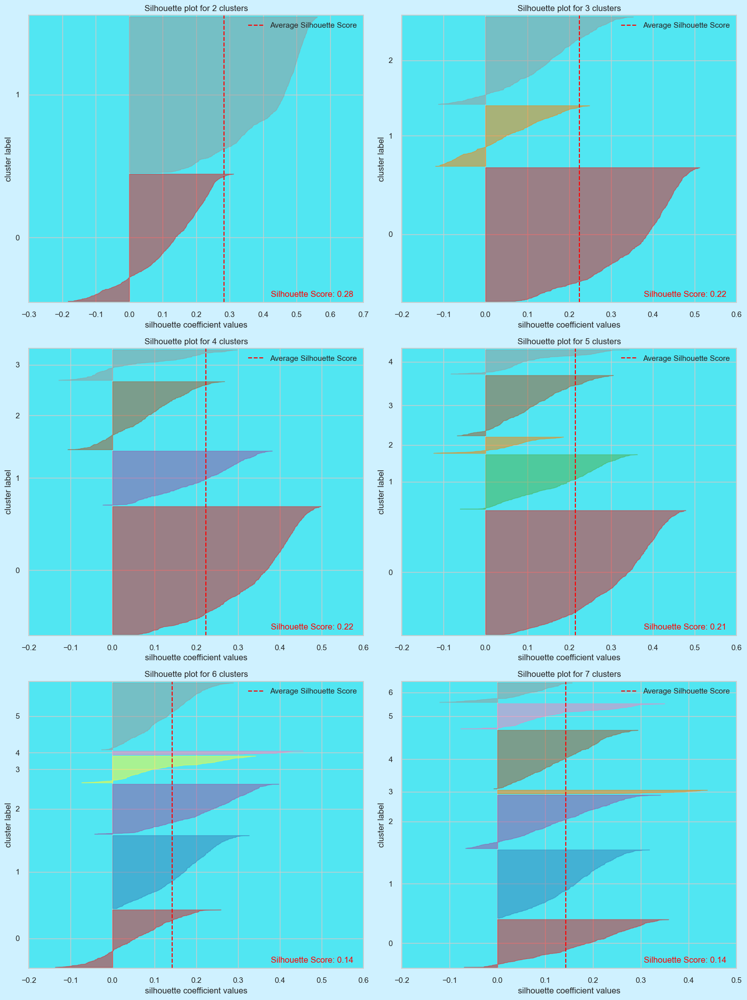

In [84]:
import matplotlib.pyplot as plt  
from sklearn.cluster import KMeans  
from yellowbrick.cluster import SilhouetteVisualizer  
from sklearn.metrics import silhouette_score  

fig, axes = plt.subplots(3, 2, figsize=(15, 20))  
axes = axes.flatten()  

for n_clusters in range(2, 8):  
    ax = axes[n_clusters - 2]  
    kmeans = KMeans(n_clusters=n_clusters, init='k-means++')  
    visualizer = SilhouetteVisualizer(kmeans, ax=ax)  
    visualizer.fit(customer_data_pca)  
    visualizer.finalize()  
    ax.set_title(f'Silhouette plot for {n_clusters} clusters')  
    score = silhouette_score(customer_data_pca, kmeans.labels_)  
    ax.text(0.97, 0.02, f'Silhouette Score: {score:.2f}', fontsize=12,
            ha='right', transform=ax.transAxes, color='red')  

plt.tight_layout()  
plt.show()

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
<h3 align="left"><font color=#215F9A>Inference:</font></h3>
Silhouette analysis serves as a technique to evaluate the separation between clusters created through clustering methods. The silhouette plot visually represents the proximity of individual points within a cluster to points in adjacent clusters, enabling a visual assessment of key parameters such as the optimal number of clusters. The silhouette coefficient ranges from <b>-1 to 1</b>, where values <b>closer to 1 indicate well-separated clusters</b>, while <b>a value of 0</b> indicates it is near the boundary between two clusters. <b>Negative values</b> imply potential misassignment to the wrong cluster.
here Silhouette Score=0.18 in n_clusters=3, 6, 7 but also from the thickness and negative value <b>n_cluster=2</b> is a better choice.



<a id="buildKMeans"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 12: Build K_Means Model </p>

⬆️[Tabel of Contents](#contents_tabel)


In [85]:
customer_data_pca.shape

(2212, 15)

In [86]:
kmeans.labels_

array([0, 4, 0, ..., 6, 2, 4])

In [87]:
kmeans=KMeans(n_clusters=2, init='k-means++',n_init=10,max_iter=100,random_state=0)
kmeans.fit(customer_data_pca)
labels=kmeans.labels_


data_final_scale['cluster'] = labels
customer_data_pca['cluster']=labels

In [88]:
data_final_scale.describe()

,Income,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,Age,Number_Purchases,...,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Year,Number_Purchases,Acceptance_Rate_Cmp,Total_Cost,cluster
count,2212.00,2212.00,2212.00,2212.00,2212.00,2212.00,2212.00,2212.00,2212.00,2212.00,...,2212.00,2212.00,2212.00,2212.00,2212.00,2212.00,2212.00,2212.00,2212.00,2212.00
mean,-0.00,0.00,0.00,0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,...,0.00,0.00,0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,0.44
std,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,0.50
min,-2.33,-1.69,-0.91,-0.66,-0.74,-0.69,-0.66,-0.85,-2.32,-1.94,...,-0.28,-0.26,-0.12,-0.10,-0.51,-1.50,-1.94,-0.44,-1.00,0.00
25%,-0.78,-0.86,-0.83,-0.61,-0.67,-0.63,-0.63,-0.68,-0.69,-0.90,...,-0.28,-0.26,-0.12,-0.10,-0.51,-0.04,-0.90,-0.44,-0.89,0.00
50%,-0.03,-0.00,-0.38,-0.46,-0.44,-0.47,-0.46,-0.38,-0.09,0.01,...,-0.28,-0.26,-0.12,-0.10,-0.51,-0.04,0.01,-0.44,-0.35,0.00
75%,0.77,0.86,0.59,0.17,0.29,0.23,0.14,0.23,0.85,0.80,...,-0.28,-0.26,-0.12,-0.10,-0.51,-0.04,0.80,-0.44,0.73,1.00
max,5.13,1.73,3.52,4.35,6.95,4.04,5.72,5.36,2.47,3.80,...,3.57,3.82,8.53,10.47,1.96,1.42,3.80,5.45,3.18,1.00


In [89]:
customer_data_pca.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,cluster
0,4.03,-2.27,-0.81,1.98,0.37,0.68,-1.59,0.17,-0.01,-0.83,-0.64,1.10,0.20,-0.72,0.81,1
1,-3.12,0.30,-0.43,-1.51,-0.73,1.05,-0.79,-0.73,0.52,1.05,-0.63,0.86,0.65,-0.07,-0.19,0
2,1.76,-1.42,-0.72,-0.01,0.18,-0.16,0.66,-0.89,0.75,-0.48,0.38,-1.05,-0.60,0.09,0.73,1
3,-3.19,0.66,-1.10,0.41,0.31,-0.76,1.12,-0.75,0.44,1.07,0.40,-0.48,-0.01,0.14,0.24,0
4,-0.29,-0.88,0.03,-0.06,0.32,-1.35,1.01,1.24,-1.60,1.99,0.69,0.27,-0.99,-0.42,-0.03,0


In [90]:
Counter(labels).most_common()

[(0, 1237), (1, 975)]

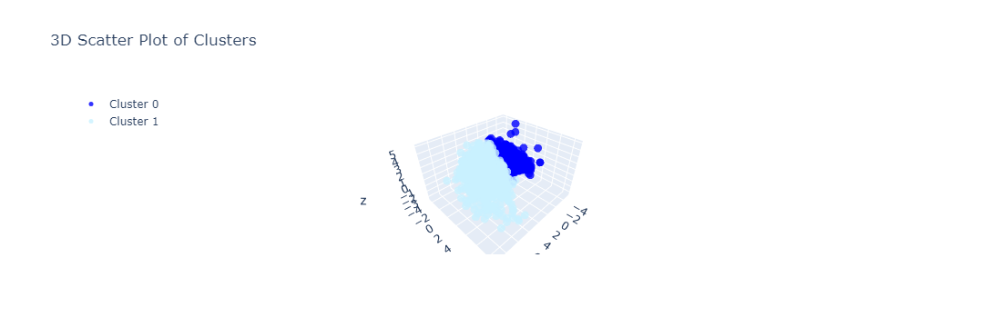

In [91]:
cluster_0=customer_data_pca[customer_data_pca['cluster']==0]
cluster_1=customer_data_pca[customer_data_pca['cluster']==1]


# Create a 3D scatter plot  
fig = go.Figure()  

# Add traces for cluster 0  
fig.add_trace(go.Scatter3d(  
    x=cluster_0['PC1'],   # Replace 'PCA1' with your actual PCA column name  
    y=cluster_0['PC2'],   # Replace 'PCA2' with your actual PCA column name  
    z=cluster_0['PC3'],
    mode='markers',  
    marker=dict(size=5, color='blue', opacity=0.8),  # Customize marker size and color  
    name='Cluster 0'        # Legend entry for the cluster  
))  

# Add traces for cluster 1  
fig.add_trace(go.Scatter3d(  
    x=cluster_1['PC1'],   # Replace 'PC1' with your actual PCA column name  
    y=cluster_1['PC2'],   # Replace 'PC2' with your actual PCA column name
    z=cluster_0['PC3'],
    mode='markers',  
    marker=dict(size=5, color='#C9F1FF', opacity=0.8),   # Customize marker size and color  
    name='Cluster 1'        # Legend entry for the cluster  
))  

# Update layout for better visualization  
fig.update_layout(  
    title='3D Scatter Plot of Clusters',  
    scene=dict(  
        xaxis_title='PC1',  
        yaxis_title='PC2',  
    ),  
    legend=dict(x=0, y=1)  
)  

# Show the figure  
fig.show()  

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
<h3 align="left"><font color=#215F9A>Inference:</font></h3>
In the end, by using different types of plots, it was determined that for this data set, customers are divided into two clusters and the key-means model is built with <b>two clusters</b>.



<a id="dbscanclustering"></a>
# <p style="background-color:#C9F1FF; font-family:calibri; font-size:130%; color:black; text-align:center; border-radius:40px 50px; padding:10px">Step 13: DBSCAN Clustering </p>

⬆️[Tabel of Contents](#contents_tabel)


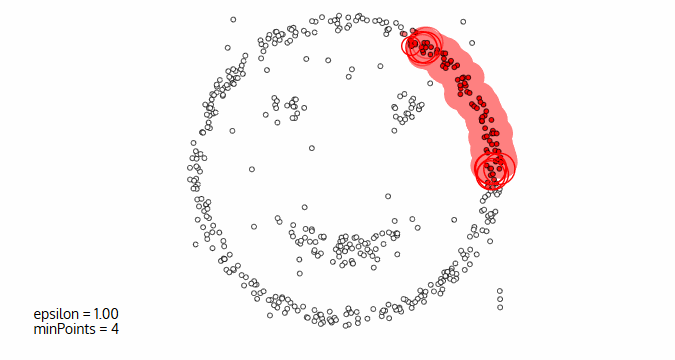

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
The most important difference between the DBSCAN and the Kmeans is that in the DBSCAN the categories are done automatically, but in the Kmeans you get the best number of categories with different methods.DBSCAN automatically determines the number of clusters based on two hyperparameters.
<b>The two main hyperparameters in DBSCAN clustering are</b>:

<b>Epsilon (ε)</b>: This parameter defines the maximum distance between two points to be considered as neighbors. Points within this distance are part of the same cluster. A smaller ε value results in smaller clusters, while a larger ε value results in larger clusters.

<b>MinPts</b>: This parameter specifies the minimum number of points required to form a cluster. Points with fewer than MinPts neighbors are considered noise. A larger MinPts value results in fewer, but potentially denser, clusters.

Choosing the appropriate values for ε and MinPts is crucial for effective DBSCAN clustering. It often requires experimentation and domain knowledge to find the best combination for a given dataset.</div>

In [92]:
customer_data_pca=customer_data_pca.iloc[:,:15]

In [93]:
dbscan=DBSCAN(eps=4,min_samples=4)
y_pred=dbscan.fit_predict(customer_data_pca)
s=silhouette_score(customer_data_pca,y_pred)
dbs=davies_bouldin_score(customer_data_pca,y_pred)
ch_score=calinski_harabasz_score(customer_data_pca,y_pred)

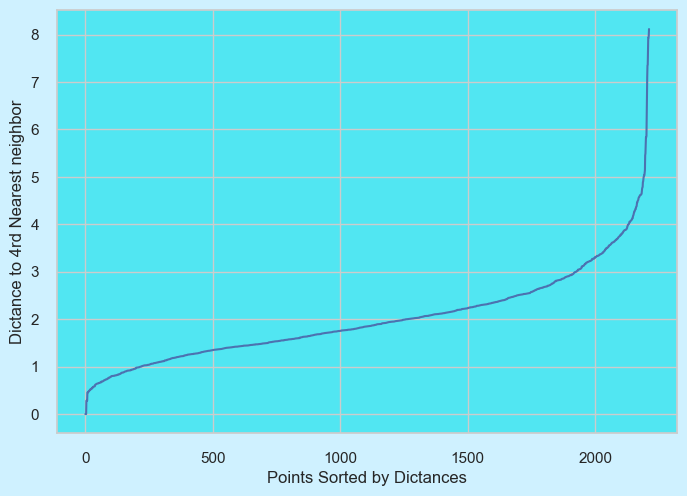

In [94]:
neighbors=NearestNeighbors(n_neighbors=4)
neighbors_fit=neighbors.fit(customer_data_pca)
distances,indices=neighbors_fit.kneighbors(customer_data_pca)
dictances=np.sort(distances[:,3])
plt.plot(dictances)
plt.xlabel('Points Sorted by Dictances')
plt.ylabel('Dictance to 4rd Nearest neighbor')
plt.show()

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
<b>the plot shows:</b>
<b>Elbow Point</b>: The plot often exhibits an "elbow" point where the slope of the curve changes significantly. This elbow point is indicative of a natural separation between core points and noise points.(elbow=4)Therefore, the exact value of epsilon is equal to 4. One of the models to determine the parameters is to use the K-Distance plot, which arranges the data based on the distance on the X-axis and finds the distance of each data to the fourth neighbor on the Y-axis.(for example min_samples=4)</div>


In [95]:
print('silhouette_score',s,'\n','davies_bouldin_score',dbs,'\n','calinski_harabasz_score',ch_score)

silhouette_score 0.14435700932536258 
 davies_bouldin_score 1.6761341968525458 
 calinski_harabasz_score 43.56338792133008


In [96]:
labels=dbscan.labels_
customer_data_pca['cluster']=labels
customer_data_pca.describe().iloc[:,15:]


,cluster
count,2212.00
mean,0.15
std,0.87
min,-1.00
25%,0.00
50%,0.00
75%,0.00
max,9.00


<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
<h3 align="left"><font color=#215F9A>Inference:</font></h3>
In the end, by using different types of plots, it was determined that for this data set, customers are divided into two clusters and the DBSCAN model is built with <b>11 clusters</b>.



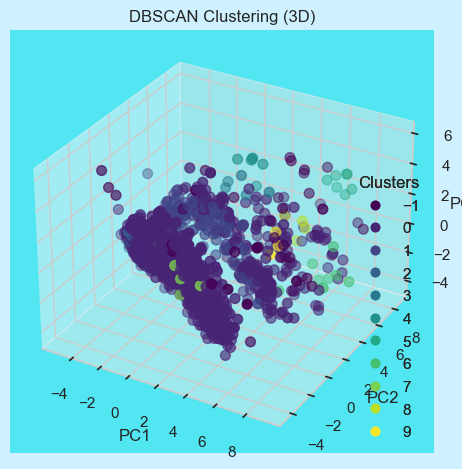

In [97]:
# Assuming you have a DataFrame named 'customer_data_pca' with a 'Cluster' column

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

# Choose the three PCA components you want to visualize (e.g., 'PC1', 'PC2', 'PC3')
x = customer_data_pca['PC1']
y = customer_data_pca['PC2']
z = customer_data_pca['PC3']

# Scatter plot with color-coded clusters
scatter = ax.scatter(x, y, z, c=customer_data_pca['cluster'], cmap='viridis', s=50)

# Set labels and title
ax.set_xlabel('PC1')
ax.set_ylabel('PC2')
ax.set_zlabel('PC3')
ax.set_title('DBSCAN Clustering (3D)')

# Add a legend to explain the colors
legend1 = ax.legend(*scatter.legend_elements(), loc="lower right", title="Clusters")
ax.add_artist(legend1)

# Show the plot
plt.show()

<div style="border-radius:10px; padding: 15px; background-color:  #C9F1FF; font-size:120%; text-align:left">
<h3 align="left"><font color=#215F9A>Inference:</font></h3>
The result after developing the DB Scan model and determining the parameters with different methods was determined.